In [61]:
!git clone https://github.com/Omid-Nejati/MedViT.git

fatal: destination path 'MedViT' already exists and is not an empty directory.


In [62]:
!nvidia-smi

Fri Apr 12 12:17:48 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 551.61                 Driver Version: 551.61         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Quadro P4000                 WDDM  |   00000000:01:00.0  On |                  N/A |
| 46%   37C    P8              8W /  105W |    4065MiB /   8192MiB |     11%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [63]:
kill 4032

SyntaxError: invalid syntax (1986483072.py, line 1)

In [ ]:
!pip3 install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121

Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://download.pytorch.org/whl/cu121
     ---------------------------------------- 0.0/4.0 MB ? eta -:--:--
     -------------------- ------------------- 2.0/4.0 MB 65.1 MB/s eta 0:00:01
     ---------------------------------------  4.0/4.0 MB 65.1 MB/s eta 0:00:01
     ---------------------------------------  4.0/4.0 MB 65.1 MB/s eta 0:00:01
     ---------------------------------------- 4.0/4.0 MB 25.9 MB/s eta 0:00:00
     ---------------------------------------- 0.0/2.5 GB ? eta -:--:--
     ---------------------------------------- 0.0/2.5 GB 7.9 MB/s eta 0:05:10
     ---------------------------------------- 0.0/2.5 GB 15.0 MB/s eta 0:02:45
     ---------------------------------------- 0.0/2.5 GB 20.1 MB/s eta 0:02:02
     ---------------------------------------- 0.0/2.5 GB 23.3 MB/s eta 0:01:46
     ---------------------------------------- 0.0/2.5 GB 26.3 MB/s eta 0:01:34
     ------

In [ ]:
import gc
import torch
gc.collect()

torch.cuda.empty_cache()

In [2]:
cd C:/Users/Admin/Downloads/MedViT/

C:\Users\Admin\Downloads\MedViT


In [ ]:
!pip install torchsummary

Defaulting to user installation because normal site-packages is not writeable


In [3]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import torch
import torch.nn as nn
import torch.optim as optim

import torchvision.utils
from torchvision import models
import torchvision.datasets as dsets
import torchvision.transforms as transforms
from torchsummary import summary

In [ ]:
!pip install timm
!pip install einops

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [ ]:
!pip3 install ipywidgets --user

In [4]:
from MedViT import MedViT_small as tiny

In [5]:
model = tiny()

initialize_weights...


In [7]:
model.proj_head[0]
model.proj_head[0] = torch.nn.Linear(in_features=1024, out_features=10, bias=True)

In [8]:
model = model.cuda()

In [ ]:
!pip install medmnist

Defaulting to user installation because normal site-packages is not writeable


In [9]:
from tqdm import tqdm
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
import torchvision.transforms as transforms

import medmnist
from medmnist import INFO, Evaluator

In [10]:
data_flag = 'bloodmnist'
# [tissuemnist, pathmnist, chestmnist, dermamnist, octmnist,
# pnemoniamnist, retinamnist, breastmnist, bloodmnist, tissuemnist, organamnist, organcmnist, organsmnist]
download = True

NUM_EPOCHS = 1
BATCH_SIZE = 10
lr = 0.005

info = INFO[data_flag]
task = info['task']
n_channels = info['n_channels']
n_classes = len(info['label'])

DataClass = getattr(medmnist, info['python_class'])

In [15]:
from torchvision.transforms.transforms import Resize
# preprocessing
train_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.Lambda(lambda image: image.convert('RGB')),
    torchvision.transforms.AugMix(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[.5], std=[.5])
])
test_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.Lambda(lambda image: image.convert('RGB')),
    transforms.ToTensor(),
    transforms.Normalize(mean=[.5], std=[.5])
])

# load the data
train_dataset = DataClass(split='train', transform=train_transform, download=download)
test_dataset = DataClass(split='test', transform=test_transform, download=download)

# pil_dataset = DataClass(split='train', download=download)

# encapsulate data into dataloader form
train_loader = data.DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
train_loader_at_eval = data.DataLoader(dataset=train_dataset, batch_size=2*BATCH_SIZE, shuffle=False)
test_loader = data.DataLoader(dataset=test_dataset, batch_size=2*BATCH_SIZE, shuffle=False)

train_dataset.montage(length=1)

Using downloaded and verified file: C:\Users\Admin\.medmnist\retinamnist.npz
Using downloaded and verified file: C:\Users\Admin\.medmnist\retinamnist.npz


In [11]:
from torchvision.transforms.transforms import Resize
# preprocessing
train_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.Lambda(lambda image: image.convert('RGB')),
    torchvision.transforms.AugMix(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[.5], std=[.5])
])
test_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.Lambda(lambda image: image.convert('RGB')),
    transforms.ToTensor(),
    transforms.Normalize(mean=[.5], std=[.5])
])

# load the data
train_dataset = DataClass(split='train', transform=train_transform, download=download)
test_dataset = DataClass(split='test', transform=test_transform, download=download)

# pil_dataset = DataClass(split='train', download=download)

# encapsulate data into dataloader form
train_loader = data.DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
train_loader_at_eval = data.DataLoader(dataset=train_dataset, batch_size=2*BATCH_SIZE, shuffle=False)
test_loader = data.DataLoader(dataset=test_dataset, batch_size=2*BATCH_SIZE, shuffle=False)

Using downloaded and verified file: C:\Users\Admin\.medmnist\bloodmnist.npz
Using downloaded and verified file: C:\Users\Admin\.medmnist\bloodmnist.npz


In [12]:
print(train_dataset)
print("===================")
print(test_dataset)

Dataset BloodMNIST of size 28 (bloodmnist)
    Number of datapoints: 11959
    Root location: C:\Users\Admin\.medmnist
    Split: train
    Task: multi-class
    Number of channels: 3
    Meaning of labels: {'0': 'basophil', '1': 'eosinophil', '2': 'erythroblast', '3': 'immature granulocytes(myelocytes, metamyelocytes and promyelocytes)', '4': 'lymphocyte', '5': 'monocyte', '6': 'neutrophil', '7': 'platelet'}
    Number of samples: {'train': 11959, 'val': 1712, 'test': 3421}
    Description: The BloodMNIST is based on a dataset of individual normal cells, captured from individuals without infection, hematologic or oncologic disease and free of any pharmacologic treatment at the moment of blood collection. It contains a total of 17,092 images and is organized into 8 classes. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images with resolution 3×360×363 pixels are center-cropped into 3×200×200, and then resized into 3×28×28.
    Lice

In [13]:
from MedViT import MedViT_small, MedViT_base, MedViT_large

model = MedViT_small(num_classes = n_classes).cuda()
#model = MedViT_base(num_classes = n_classes).cuda()
#model = MedViT_large(num_classes = n_classes).cuda()

initialize_weights...


In [14]:
if task == "multi-label, binary-class":
    criterion = nn.BCEWithLogitsLoss()
else:
    criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=lr, momentum=0.9)


In [ ]:
!pip install -q foolbox

In [ ]:
pip uninstall torch

In [15]:
# train

for epoch in range(NUM_EPOCHS):
    train_correct = 0
    train_total = 0
    test_correct = 0
    test_total = 0
    print('Epoch [%d/%d]'% (epoch+1, NUM_EPOCHS))
    model.train()
    for inputs, targets in tqdm(train_loader):
        inputs, targets = inputs.cuda(), targets.cuda()
        # forward + backward + optimize
        optimizer.zero_grad()
        outputs = model(inputs)

        if task == 'multi-label, binary-class':
            targets = targets.to(torch.float32)
            loss = criterion(outputs, targets)
        else:
            targets = targets.squeeze().long()
            loss = criterion(outputs, targets)

        loss.backward()
        optimizer.step()

Epoch [1/1]


100%|██████████| 1196/1196 [09:22<00:00,  2.13it/s]


Performing RobustBench/AutoAttack

In [ ]:
!pip install robustbench

Defaulting to user installation because normal site-packages is not writeable
  Using cached autoattack-0.1-py3-none-any.whl


In [ ]:
pip install git+https://github.com/RobustBench/robustbench.git

Note: you may need to restart the kernel to use updated packages.


  Running command git clone --filter=blob:none --quiet https://github.com/RobustBench/robustbench.git 'C:\Users\Admin\AppData\Local\Temp\pip-req-build-prvlx30q'


Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/RobustBench/robustbench.git to c:\users\admin\appdata\local\temp\pip-req-build-prvlx30q
  Resolved https://github.com/RobustBench/robustbench.git to commit 34dda3a2367b6e2d04027fbef42b7c2d6cedf4a3
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Using cached autoattack-0.1-py3-none-any.whl


In [ ]:
!pip install --upgrade robustbench

Defaulting to user installation because normal site-packages is not writeable
  Using cached autoattack-0.1-py3-none-any.whl


In [ ]:
!pip install git+https://github.com/fra31/auto-attack

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/fra31/auto-attack to c:\users\admin\appdata\local\temp\pip-req-build-owa0h82r
  Resolved https://github.com/fra31/auto-attack to commit a39220048b3c9f2cca9a4d3a54604793c68eca7e
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'


  Running command git clone --filter=blob:none --quiet https://github.com/fra31/auto-attack 'C:\Users\Admin\AppData\Local\Temp\pip-req-build-owa0h82r'


In [15]:
pip install robustbench

Defaulting to user installation because normal site-packages is not writeable
  Using cached autoattack-0.1-py3-none-any.whl
Note: you may need to restart the kernel to use updated packages.


In [84]:
!pip install numpy

Defaulting to user installation because normal site-packages is not writeable


In [29]:
pip install --upgrade scikit-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [16]:
!pip install torchattacks

Defaulting to user installation because normal site-packages is not writeable


In [17]:
import torchattacks
from torchattacks import PGD, FGSM

In [18]:
BATCH_SIZE = 5
test_loader = data.DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [20]:
import torch

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Ensure the model is on the correct device
model = model.to(device)


In [22]:
import torch
import torchattacks

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Ensure the model is on the correct device
model = model.to(device)

model.eval()

correct = 0
total = 0

atk = torchattacks.FGSM(model, eps=0.01)

for images, labels in test_loader:
    # Move images and labels to the device
    images, labels = images.to(device), labels.to(device)

    # Ensure labels are 1D and of type torch.LongTensor
    labels = labels.squeeze(1).long()
    
    # Generate adversarial examples
    adv_images = atk(images, labels)

    # Move adversarial images to the device
    adv_images = adv_images.to(device)
    
    outputs = model(adv_images)

    _, predicted = torch.max(outputs.data, 1)

    total += labels.size(0)
    correct += (predicted == labels).sum().item()  # .sum().item() to get the count

print('FGSM Robust accuracy: %.2f %%' % (100 * float(correct) / total))


FGSM Robust accuracy: 31.75 %


In [24]:
import torch
from torchattacks import PGD

# Set the model to evaluation mode
model.eval()

correct = 0
total = 0

atk = PGD(model, eps=8/255, alpha=4/255, steps=10, random_start=True)

for images, labels in test_loader:
    # Squeeze labels to remove extra dimensions
    labels = labels.squeeze(1)
    
    # Convert labels to torch.LongTensor
    labels = labels.long()
    
    # Apply PGD attack
    images = atk(images, labels)
    
    # Move images and labels to the correct device
    images, labels = images.to(device), labels.to(device)
    
    # Forward pass
    outputs = model(images)

    # Get predicted labels
    _, predicted = torch.max(outputs.data, 1)

    # Update counts
    total += labels.size(0)
    correct += (predicted == labels).sum().item()

# Compute accuracy
accuracy = 100 * correct / total
print('PGD Robust accuracy: %.2f %%' % accuracy)


KeyboardInterrupt: 

In [13]:
!pip install scikit-multilearn
!pip install mord scikit-learn

Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/89.4 kB ? eta -:--:--
   ---- ----------------------------------- 10.2/89.4 kB ? eta -:--:--
   ------------- -------------------------- 30.7/89.4 kB 325.1 kB/s eta 0:00:01
   --------------------------- ------------ 61.4/89.4 kB 544.7 kB/s eta 0:00:01
   ------------------------------------ --- 81.9/89.4 kB 651.6 kB/s eta 0:00:01
   ---------------------------------------- 89.4/89.4 kB 561.2 kB/s eta 0:00:00
Defaulting to user installation because normal site-packages is not writeable
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing me

In [14]:
!pip install lifelines

Defaulting to user installation because normal site-packages is not writeable
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
   ---------------------------------------- 0.0/349.2 kB ? eta -:--:--
   ---------------------------------------- 0.0/349.2 kB ? eta -:--:--
   ---------------------------------------- 0.0/349.2 kB ? eta -:--:--
   - -------------------------------------- 10.2/349.2 kB ? eta -:--:--
   - -------------------------------------- 10.2/349.2 kB ? eta -:--:--
   - -------------------------------------- 10.2/349.2 kB ? eta -:--:--
   - -------------------------------------- 10.2/349.2 kB

==> Evaluating Multiple Images...
Image 0 in test set:
True Class: 3, Predicted Class: 5


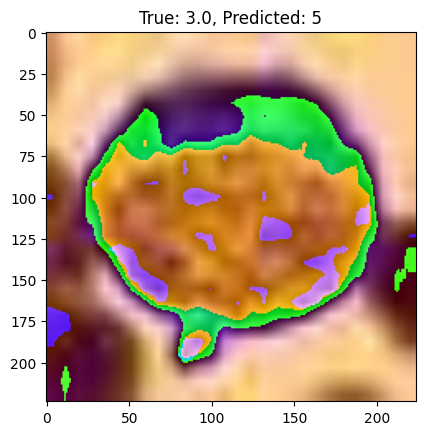

Misclassified
Image 1 in test set:
True Class: 0, Predicted Class: 0


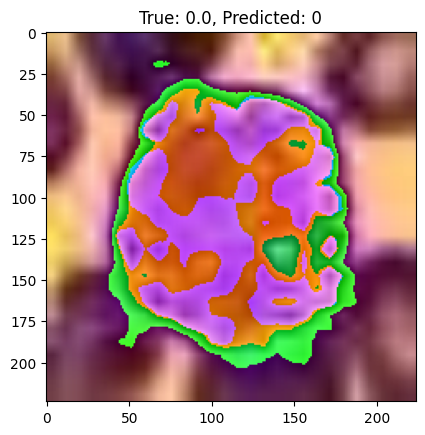

Correctly Classified
Image 2 in test set:
True Class: 1, Predicted Class: 1


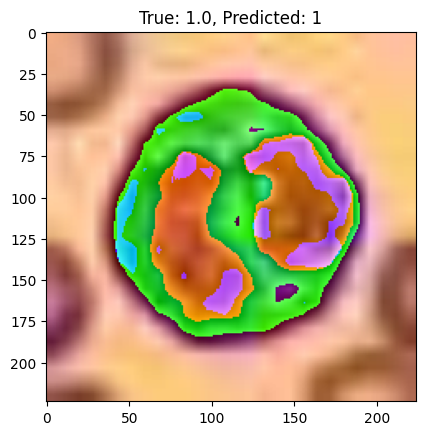

Correctly Classified
Image 3 in test set:
True Class: 3, Predicted Class: 6


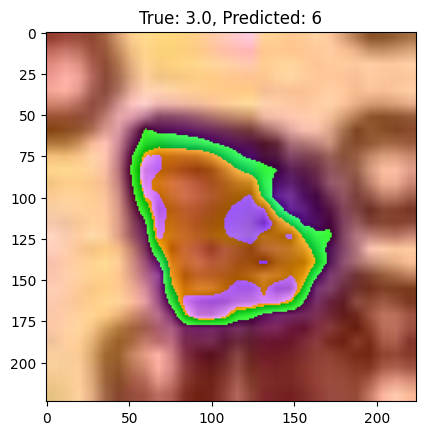

Misclassified
Image 4 in test set:
True Class: 1, Predicted Class: 1


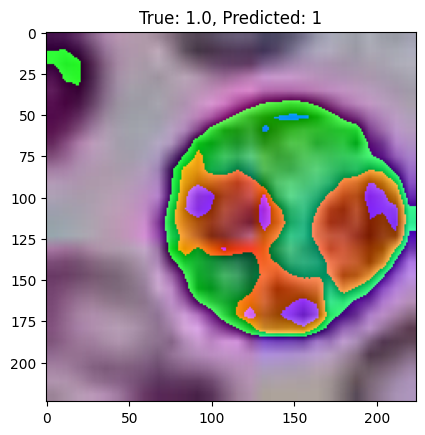

Correctly Classified


In [16]:
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage

def test_individual(split, image_index):
    model.eval()

    data_loader = test_loader  # Assuming you want to test on a separate dataset

    with torch.no_grad():
        # Retrieve a specific image from the dataset
        input, target = next(iter(data_loader))
        input, target = input.cuda(), target.cuda()

        # Select a specific image from the batch
        input_single = input[image_index].unsqueeze(0)
        target_single = target[image_index].unsqueeze(0)

        output = model(input_single)

        # ...

        if task == 'multi-label, binary-class':
            target_single = target_single.to(torch.float32)
            output = output.softmax(dim=-1)
        else:
            target_single = target_single.squeeze().long()
            output = output.softmax(dim=-1)
            target_single = target_single.float()

# ...


        output_class = torch.argmax(output).cpu().item()
        target_class = target_single.cpu().numpy()

        # Display result for the specified image
        # ...

        # Display result for the specified image
        print(f'Image {image_index} in {split} set:')
        print(f'True Class: {int(target_class)}, Predicted Class: {output_class}')

        # Display the image
        to_pil = ToPILImage()
        image = to_pil(input_single.squeeze().cpu())
        plt.imshow(image)
        plt.title(f'True: {(target_class)}, Predicted: {output_class}')
        plt.show()

        if output_class == target_class:
            print('Correctly Classified')
        else:
            print('Misclassified')

# ...

def evaluate_multiple_images(split, num_images):
    for i in range(num_images):
        test_individual(split, image_index=i)

# ...

print('==> Evaluating Multiple Images...')
evaluate_multiple_images('test', num_images=5)


Checking Robustness Benchmark

In [1]:
pip install git+https://github.com/RobustBench/robustbench.git

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/RobustBench/robustbench.git to c:\users\admin\appdata\local\temp\pip-req-build-4br2j1e6
  Resolved https://github.com/RobustBench/robustbench.git to commit 34dda3a2367b6e2d04027fbef42b7c2d6cedf4a3
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Cloning https://github.com/fra31/auto-attack.git (to revision a39220048b3c9f2cca9a4d3a54604793c68eca7e) to c:\users\admin\appdata\local\temp\pip-install-5w6ocetq\autoattack_4eb13818e248467798975a819b08d9ae
  Resolved https://github.com/fra31/auto-attack.git 

  Running command git clone --filter=blob:none --quiet https://github.com/RobustBench/robustbench.git 'C:\Users\Admin\AppData\Local\Temp\pip-req-build-4br2j1e6'
  Running command git clone --filter=blob:none --quiet https://github.com/fra31/auto-attack.git 'C:\Users\Admin\AppData\Local\Temp\pip-install-5w6ocetq\autoattack_4eb13818e248467798975a819b08d9ae'
  Running command git rev-parse -q --verify 'sha^a39220048b3c9f2cca9a4d3a54604793c68eca7e'
  Running command git fetch -q https://github.com/fra31/auto-attack.git a39220048b3c9f2cca9a4d3a54604793c68eca7e


In [23]:
# evaluation

def test(split):
    model.eval()
    y_true = torch.tensor([]).cuda()
    y_score = torch.tensor([]).cuda()

    data_loader = train_loader_at_eval if split == 'train' else test_loader

    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs, targets = inputs.cuda(), targets.cuda()
            outputs = model(inputs)

            if task == 'multi-label, binary-class':
                targets = targets.to(torch.float32)
                outputs = outputs.softmax(dim=-1)
            else:
                targets = targets.squeeze().long()
                outputs = outputs.softmax(dim=-1)
                targets = targets.float().resize_(len(targets), 1)

            y_true = torch.cat((y_true, targets), 0)
            y_score = torch.cat((y_score, outputs), 0)

        y_true = y_true.cpu().numpy()
        y_score = y_score.detach().cpu().numpy()

        evaluator = Evaluator(data_flag, split)
        metrics = evaluator.evaluate(y_score)

        print('%s  auc: %.3f  acc:%.3f' % (split, *metrics))


print('==> Evaluating ...')
test('train')
test('test')

==> Evaluating ...
train  auc: 0.620  acc:0.347
test  auc: 0.580  acc:0.385


In [17]:
split = 'test'

model.eval()
y_true = torch.tensor([])
y_score = torch.tensor([])

data_loader = train_loader_at_eval if split == 'train' else test_loader

with torch.no_grad():
    for inputs, targets in data_loader:
        inputs = inputs.cuda()
        outputs = model(inputs)
        outputs = outputs.softmax(dim=-1)
        y_score = torch.cat((y_score, outputs.cpu()), 0)

    y_score = y_score.detach().numpy()

    evaluator = Evaluator(data_flag, split, size=224)
    metrics = evaluator.evaluate(y_score)

    print('%s  auc: %.3f  acc: %.3f' % (split, *metrics))

test  auc: 0.969  acc: 0.784


In [21]:
print(f"x_test minimum: {x_test.min().item()}")
print(f"x_test maximum: {x_test.max().item()}")

x_test minimum: -1.0
x_test maximum: 0.9921568632125854


In [ ]:
Performing Adversarial Attack using FGSM method

In [15]:
#  pip
!pip install torchattacks

#  source
!pip install git+https://github.com/Harry24k/adversarial-attacks-pytorch.git

#  git clone
!git clone https://github.com/Harry24k/adversarial-attacks-pytorch.git

Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/48.9 kB ? eta -:--:--
     -------- ------------------------------- 10.2/48.9 kB ? eta -:--:--
     ----------------------- -------------- 30.7/48.9 kB 435.7 kB/s eta 0:00:01
     ------------------------------- ------ 41.0/48.9 kB 326.8 kB/s eta 0:00:01
     ------------------------------- ------ 41.0/48.9 kB 326.8 kB/s eta 0:00:01
     -------------------------------------- 48.9/48.9 kB 246.3 kB/s eta 0:00:00
   ---------------------------------------- 0.0/142.0 kB ? eta -:--:--
   ---------------------------------------- 0.0/142.0 kB ? eta -:--:--
   -------- ------------------------------- 30.7/142.0 kB ? eta -:--:--
   ----------------- ---------------------- 61.4/142.0 kB 1.1 MB/s eta 0:00:01
   ----------------------- ---------------- 81.9/142.0 kB 1.2 MB/s eta 0:00:01
   -------------------------------- ----- 122.9/142.0 kB 804.6 kB/s eta 0:00:01
   --

  Running command git clone --filter=blob:none --quiet https://github.com/Harry24k/adversarial-attacks-pytorch.git 'C:\Users\Admin\AppData\Local\Temp\pip-req-build-nx3uqz4x'
Cloning into 'adversarial-attacks-pytorch'...
error: 2920 bytes of body are still expected
fetch-pack: unexpected disconnect while reading sideband packet
fatal: early EOF
fatal: fetch-pack: invalid index-pack output


In [18]:
!git clone https://github.com/Harry24k/adversarial-attacks-pytorch.git

Cloning into 'adversarial-attacks-pytorch'...


In [16]:
cd C:/Users/Admin/Downloads/MedViT/adversarial-attacks-pytorch

C:\Users\Admin\Downloads\MedViT\adversarial-attacks-pytorch


In [23]:
!pip install -e .

Defaulting to user installation because normal site-packages is not writeable
Obtaining file:///C:/Users/Admin/Downloads/MedViT/adversarial-attacks-pytorch
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Installing backend dependencies: started
  Installing backend dependencies: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
  Building editable for torchattacks (pyproject.toml): started
  Building editable for torchattacks (pyproject.toml): finished with status 'done'
  Created wheel for torchattacks: filename=torchattacks-3.5.1-0.editable-py3-none-any.whl size=3

In [17]:
print(len(train_loader))
print(len(test_loader))

673
45


In [ ]:
#Performing FGSM ATTACK

In [18]:
import torch
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage, transforms

to_pil = ToPILImage()

# Normalize input image
normalize = transforms.Normalize(mean=[.5], std=[.5])

# Define device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def fgsm_attack(model, input, target, epsilon):
    """
    FGSM attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label (for untargeted attacks, set to None).
        epsilon: Epsilon value for perturbation magnitude.

    Returns:
        adv_input: Adversarial input tensor.
        adv_output: Model output on the adversarial example.
    """
    model.eval()  # Set model to evaluation mode

    # Detach and clone the input tensor (ensure on the same device as model)
    input = input.detach().clone().to(device)
    input.requires_grad_(True)  # Mark input for gradient calculation

    # Original prediction
    output = model(input)
    loss = torch.nn.functional.cross_entropy(output, torch.tensor([target]).to(device) if target is not None else output.detach().max(1)[1])

    # Backward pass to obtain the gradient
    model.zero_grad()
    loss.backward()

    # FGSM attack: perturb the input image with gradient sign
    perturbation = epsilon * input.grad.sign()
    adv_input = input + perturbation
    adv_input = torch.clamp(adv_input, min=0.0, max=1.0)  # Clamp to valid range (0.0 to 1.0)

    # Perform inference on the adversarial example
    adv_output = model(adv_input)

    return adv_input, adv_output


def iterative_fgsm_attack(model, input, target, epsilon, iterations):
    """
    Iterative FGSM attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label (for untargeted attacks, set to None).
        epsilon: Epsilon value for perturbation magnitude.
        iterations: Number of iterations for the iterative attack.

    Returns:
        adv_input: Adversarial input tensor after multiple iterations.
    """
    for _ in range(iterations):
        adv_input, _ = fgsm_attack(model, input, target, epsilon)
        input = adv_input.clone().detach()  # Detach and clone for next iteration
        input.requires_grad_(True)  # Mark input for gradient calculation in the next iteration
    return adv_input


# Example usage
image_index = 0  # Choose an index from the test set
input, target = next(iter(test_loader))
input, target = input.to(device), target.to(device)  # Move to device

# Normalize and clone input for testing (check normalization process)
input_normalized = normalize(input)  # Double-check normalization
input_single = input_normalized[image_index].unsqueeze(0).clone().detach()
target_single = target[image_index].item()  # Get target class

# Original prediction
output = model(input_single)
output_class_original = torch.argmax(output).item()

# Specify epsilon for testing (start lower)
epsilon_testing = 0.2 # Adjust as needed
iterations = 5  # Number of iterations for iterative FGSM

# Choose attack function
attack_fn = fgsm_attack if iterations == 0 else iterative_fgsm_attack

# FGSM attack with conditional unpacking
if iterations == 0:
  adv_input, adv_output = attack_fn(model, input_single, None, epsilon=epsilon_testing)  # Untargeted attack (target=None)
else:
  adv_input = attack_fn(model, input_single, None, epsilon=epsilon_testing, iterations=iterations)  # Untargeted attack
  adv_output = model(adv_input)  # Obtain output for iterative FGSM

# Check attack status
print('Attack Status:', 'Successful' if torch.argmax(adv_output).item() != target_single else 'Unsuccessful')

# Calculate adversarial prediction
output_class_adversarial = torch.argmax(adv_output).item()
print('Original Prediction:', output_class_original)
print('Adversarial Prediction:', output_class_adversarial)

Attack Status: Successful
Original Prediction: 1
Adversarial Prediction: 0


In [ ]:
#2nd FGSM Attack Code that attacks only 10-20 images from the dataset

In [34]:
print(len(test_loader))

45


Performing adversarial attack on a subset of images...
Image Index: 2471
Attack Status: Successful
Original Prediction: 2
Adversarial Prediction: 7
------------------------


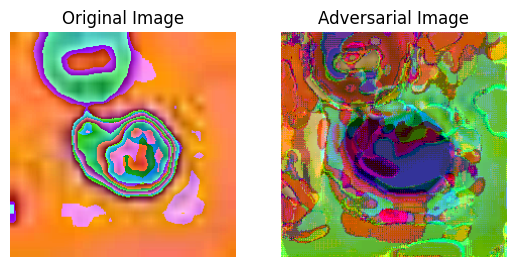

Image Index: 126
Attack Status: Successful
Original Prediction: 4
Adversarial Prediction: 1
------------------------


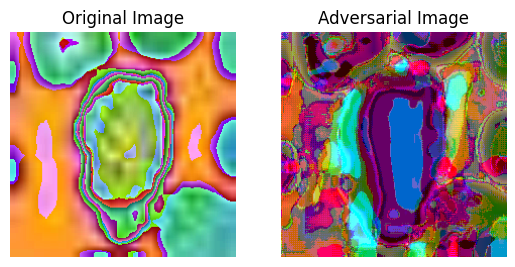

Image Index: 2626
Attack Status: Unsuccessful
Original Prediction: 1
Adversarial Prediction: 1
------------------------


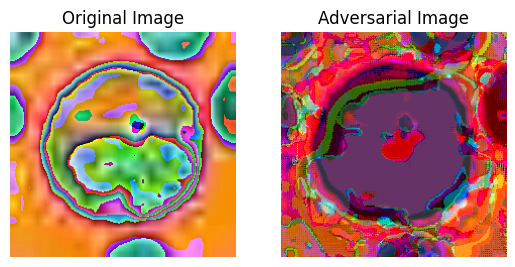

Image Index: 58
Attack Status: Successful
Original Prediction: 6
Adversarial Prediction: 1
------------------------


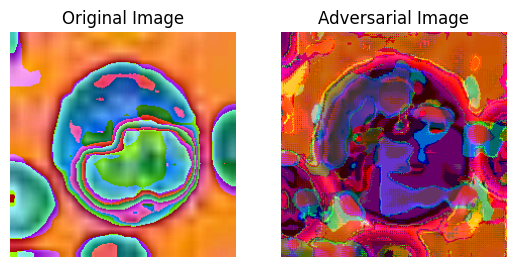

Image Index: 187
Attack Status: Successful
Original Prediction: 4
Adversarial Prediction: 7
------------------------


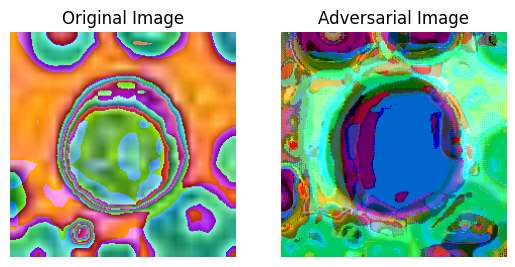

Image Index: 178
Attack Status: Successful
Original Prediction: 6
Adversarial Prediction: 7
------------------------


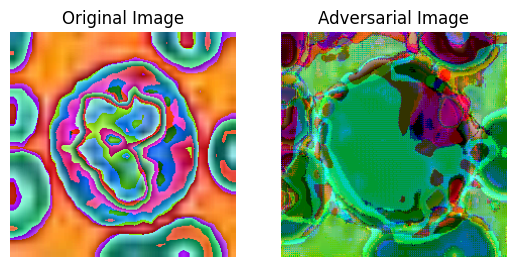

Image Index: 3150
Attack Status: Unsuccessful
Original Prediction: 7
Adversarial Prediction: 7
------------------------


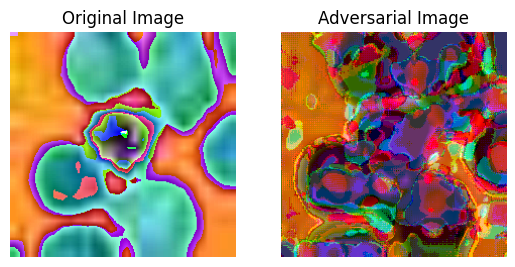

Image Index: 2979
Attack Status: Successful
Original Prediction: 5
Adversarial Prediction: 7
------------------------


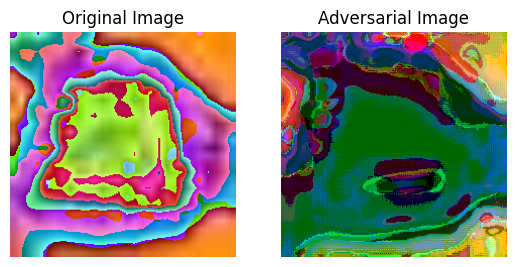

Image Index: 1536
Attack Status: Successful
Original Prediction: 1
Adversarial Prediction: 7
------------------------


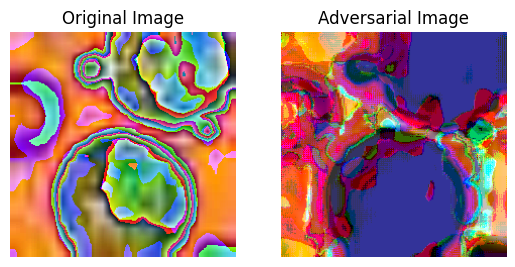

Image Index: 363
Attack Status: Successful
Original Prediction: 6
Adversarial Prediction: 1
------------------------


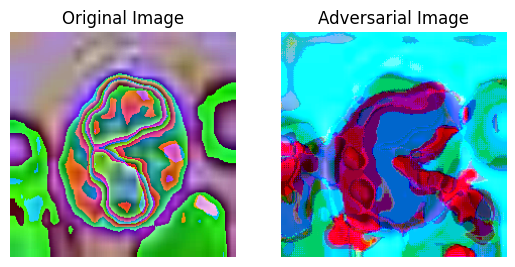

In [18]:
import torch
import random
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage, transforms
import torchvision.utils as utils
to_pil = ToPILImage()

# Normalize input image
normalize = transforms.Normalize(mean=[.5], std=[.5])

# Define device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def fgsm_attack(model, input, target, epsilon):
    """
    FGSM attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label (for untargeted attacks, set to None).
        epsilon: Epsilon value for perturbation magnitude.

    Returns:
        adv_input: Adversarial input tensor.
        adv_output: Model output on the adversarial example.
    """
    model.eval()  # Set model to evaluation mode

    # Detach and clone the input tensor (ensure on the same device as model)
    input = input.detach().clone().to(device)
    input.requires_grad_(True)  # Mark input for gradient calculation

    # Original prediction
    output = model(input)
    loss = torch.nn.functional.cross_entropy(output, torch.tensor([target]).to(device) if target is not None else output.detach().max(1)[1])

    # Backward pass to obtain the gradient
    model.zero_grad()
    loss.backward()

    # FGSM attack: perturb the input image with gradient sign
    perturbation = epsilon * input.grad.sign()
    adv_input = input + perturbation
    adv_input = torch.clamp(adv_input, min=0.0, max=1.0)  # Clamp to valid range (0.0 to 1.0)

    # Perform inference on the adversarial example
    adv_output = model(adv_input)

    return adv_input, adv_output


def iterative_fgsm_attack(model, input, target, epsilon, iterations):
    """
    Iterative FGSM attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label (for untargeted attacks, set to None).
        epsilon: Epsilon value for perturbation magnitude.
        iterations: Number of iterations for the iterative attack.

    Returns:
        adv_input: Adversarial input tensor after multiple iterations.
    """
    for _ in range(iterations):
        adv_input, _ = fgsm_attack(model, input, target, epsilon)
        input = adv_input.clone().detach()  # Detach and clone for next iteration
        input.requires_grad_(True)  # Mark input for gradient calculation in the next iteration
    return adv_input


def perform_attack_on_subset(model, data_loader, num_images, epsilon, iterations):
    """
    Perform adversarial attack on a random subset of images from the dataset and visualize the results.

    Args:
        model: PyTorch model to be attacked.
        data_loader: DataLoader containing the dataset.
        num_images: Number of images to select randomly from the dataset.
        epsilon: Epsilon value for perturbation magnitude.
        iterations: Number of iterations for the iterative attack.
    """
    images_to_attack = random.sample(range(len(data_loader.dataset)), num_images)
    for index in images_to_attack:
        input, target = data_loader.dataset[index]
        input, target = input.unsqueeze(0).to(device), torch.tensor(target).to(device)  # Move to device and convert target to tensor

        # Normalize input
        input_normalized = normalize(input)

        # Choose attack function
        attack_fn = fgsm_attack if iterations == 0 else iterative_fgsm_attack

        # FGSM attack with conditional unpacking
        if iterations == 0:
            adv_input, adv_output = attack_fn(model, input_normalized, None, epsilon=epsilon)  # Untargeted attack (target=None)
        else:
            adv_input = attack_fn(model, input_normalized, None, epsilon=epsilon, iterations=iterations)  # Untargeted attack
            adv_output = model(adv_input)  # Obtain output for iterative FGSM

        # Check attack status
        print('Image Index:', index)
        print('Attack Status:', 'Successful' if torch.argmax(adv_output).item() != target.item() else 'Unsuccessful')

        # Calculate adversarial prediction
        output_class_adversarial = torch.argmax(adv_output).item()
        print('Original Prediction:', target.item())
        print('Adversarial Prediction:', output_class_adversarial)
        print('------------------------')

        # Convert tensors to PIL images for visualization
        original_img = to_pil(input_normalized.squeeze(0).cpu())
        adversarial_img = to_pil(adv_input.squeeze(0).cpu())

        # Plot original and adversarial images
        fig, axes = plt.subplots(1, 2)
        axes[0].imshow(original_img)
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(adversarial_img)
        axes[1].set_title('Adversarial Image')
        axes[1].axis('off')
        plt.show()

# Example usage
num_images_to_attack = 10 # Number of images to attack (reduced for demonstration)
epsilon_testing = 0.2  # Epsilon value for perturbation magnitude
iterations = 5  # Number of iterations for iterative FGSM

print('Performing adversarial attack on a subset of images...')
perform_attack_on_subset(model, test_loader, num_images_to_attack, epsilon_testing, iterations)


In [19]:
def calculate_attack_accuracy(model, adv_inputs, targets):
    """
    Calculate the attack accuracy score (Attack Success Rate - ASR).

    Args:
        model: PyTorch model.
        adv_inputs: Adversarial input tensors.
        targets: Target class labels.

    Returns:
        attack_accuracy: Attack accuracy score (ASR).
    """
    total_poisoned = len(targets)
    total_miss_classified = 0
    model.eval()
    with torch.no_grad():
        for adv_input, target in zip(adv_inputs, targets):
            outputs = model(adv_input)
            _, predicted = torch.max(outputs.data, 1)
            if predicted != target:
                total_miss_classified += 1

    attack_accuracy = total_miss_classified / total_poisoned
    return attack_accuracy


def calculate_benign_accuracy(model, inputs, targets):
    """
    Calculate the benign accuracy.

    Args:
        model: PyTorch model.
        inputs: Input tensors.
        targets: Target class labels.

    Returns:
        benign_accuracy: Benign accuracy.
    """
    total_clean = len(targets)
    total_correct_classified = 0
    model.eval()
    with torch.no_grad():
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)
        total_correct_classified = (predicted == targets).sum().item()

    benign_accuracy = total_correct_classified / total_clean
    return benign_accuracy

# Example usage
def evaluate_attack(model, test_loader, num_images_to_attack, epsilon_testing, iterations):
    """
    Evaluate the attack by calculating attack accuracy score and benign accuracy.

    Args:
        model: PyTorch model.
        test_loader: DataLoader containing the test dataset.
        num_images_to_attack: Number of images to attack.
        epsilon_testing: Epsilon value for perturbation magnitude.
        iterations: Number of iterations for iterative FGSM.

    Returns:
        attack_accuracy: Attack accuracy score.
        benign_accuracy: Benign accuracy.
    """
    images_to_attack = random.sample(range(len(test_loader.dataset)), num_images_to_attack)
    adv_inputs = []
    targets = []
    for index in images_to_attack:
        input, target = test_loader.dataset[index]
        input, target = input.unsqueeze(0).to(device), torch.tensor(target).to(device)
        input_normalized = normalize(input)

        attack_fn = fgsm_attack if iterations == 0 else iterative_fgsm_attack

        if iterations == 0:
            adv_input, _ = attack_fn(model, input_normalized, None, epsilon=epsilon_testing)
        else:
            adv_input = attack_fn(model, input_normalized, None, epsilon=epsilon_testing, iterations=iterations)
        adv_inputs.append(adv_input)
        targets.append(target)

    attack_accuracy = calculate_attack_accuracy(model, adv_inputs, targets)
    benign_accuracy = calculate_benign_accuracy(model, torch.cat(adv_inputs), torch.cat(targets))
    
    return attack_accuracy, benign_accuracy


# Example usage
attack_accuracy, benign_accuracy = evaluate_attack(model, test_loader, num_images_to_attack, epsilon_testing, iterations)
print("Attack Accuracy Score:", attack_accuracy)
print("Benign Accuracy:", benign_accuracy)

Attack Accuracy Score: 1.0
Benign Accuracy: 0.0


In [33]:
import torch.nn.functional as F
original_loss = F.cross_entropy(output, torch.tensor([target_single]).to(input_single.device))
adversarial_loss = F.cross_entropy(adv_output, torch.tensor([target_single]).to(adv_output.device))

print('Original Loss:', original_loss.item())
print('Adversarial Loss:', adversarial_loss.item())

Original Loss: 0.0016921738861128688
Adversarial Loss: 4.646782398223877


In [ ]:
## Defense Strategy Code for FGSM

Defense Strategy Code for the attack on 200 Images (Adversarial Training)

Epoch 1/1:
Iteration: 100, Loss: 2.2647504806518555, Accuracy: 20.0%


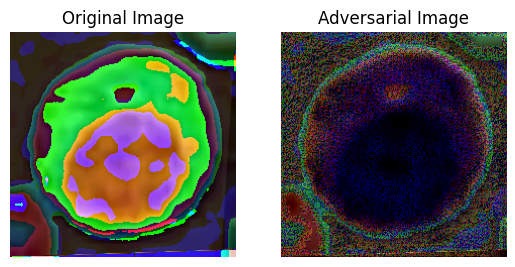

Iteration: 200, Loss: 2.0799107551574707, Accuracy: 17.5%


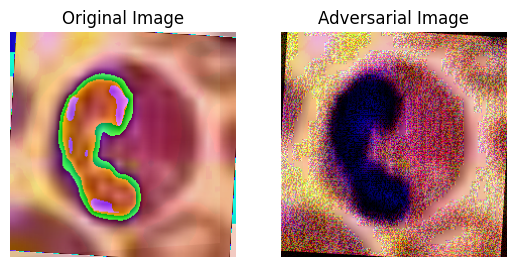

Iteration: 300, Loss: 1.7249807119369507, Accuracy: 21.333333333333332%


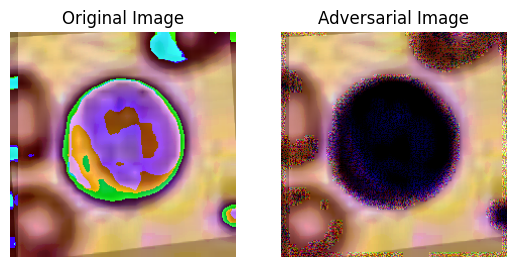

Iteration: 400, Loss: 1.5024244785308838, Accuracy: 25.25%


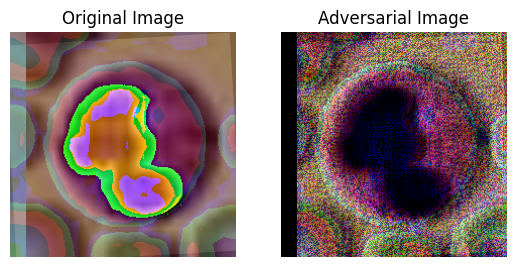

Iteration: 500, Loss: 1.7325693368911743, Accuracy: 29.6%


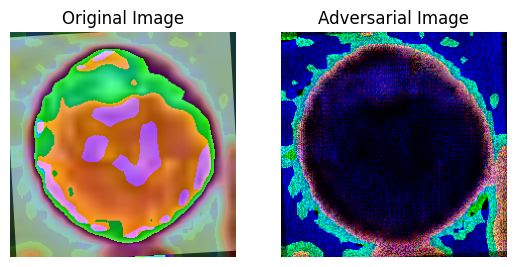

Iteration: 600, Loss: 1.4067655801773071, Accuracy: 31.666666666666668%


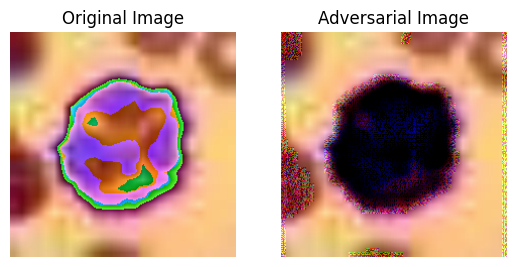

Iteration: 700, Loss: 1.7761179208755493, Accuracy: 33.285714285714285%


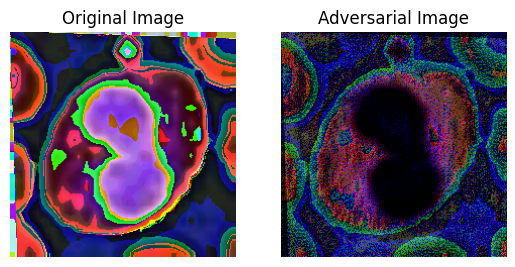

Iteration: 800, Loss: 1.0603201389312744, Accuracy: 35.25%


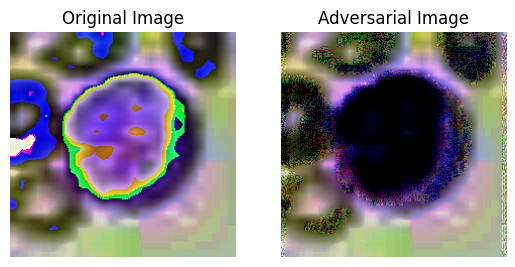

Iteration: 900, Loss: 1.0831754207611084, Accuracy: 36.77777777777778%


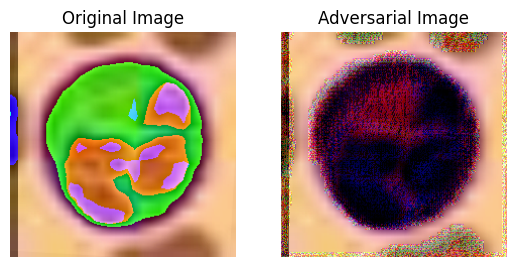

Iteration: 1000, Loss: 1.1865723133087158, Accuracy: 38.1%


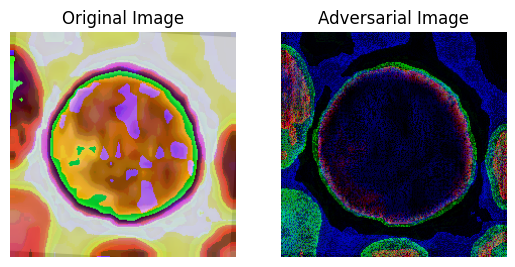

Iteration: 1100, Loss: 0.9883521795272827, Accuracy: 39.90909090909091%


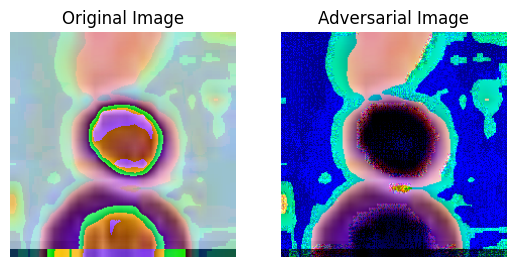

Iteration: 1200, Loss: 0.7870007753372192, Accuracy: 41.416666666666664%


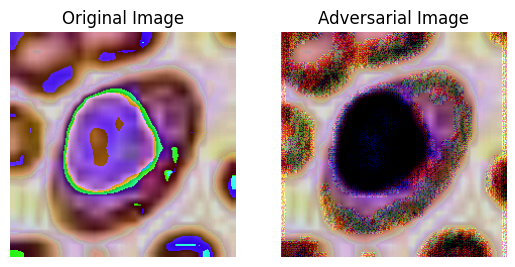

Iteration: 1300, Loss: 0.8139627575874329, Accuracy: 42.76923076923077%


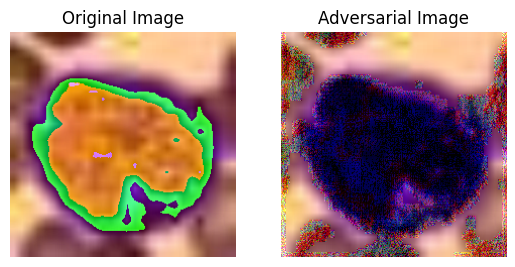

Iteration: 1400, Loss: 1.1007285118103027, Accuracy: 43.57142857142857%


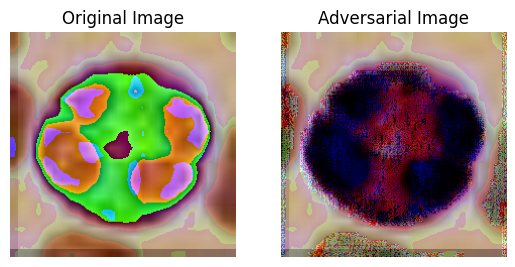

Iteration: 1500, Loss: 1.3596129417419434, Accuracy: 44.8%


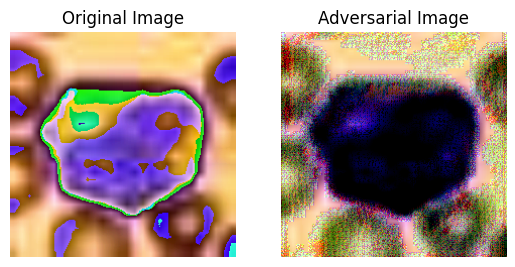

Iteration: 1600, Loss: 1.2463223934173584, Accuracy: 46.0%


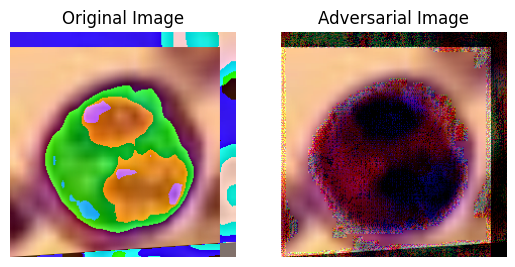

Iteration: 1700, Loss: 1.2275782823562622, Accuracy: 47.11764705882353%


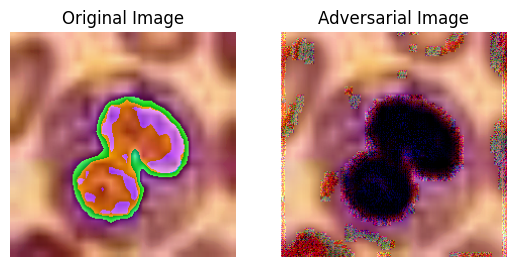

Iteration: 1800, Loss: 1.122468113899231, Accuracy: 47.27777777777778%


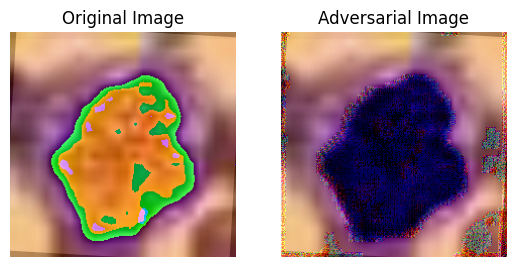

Iteration: 1900, Loss: 0.9576643109321594, Accuracy: 48.31578947368421%


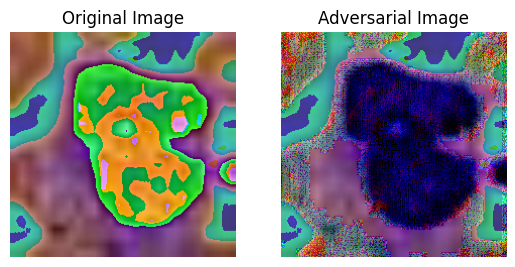

Iteration: 2000, Loss: 0.6814903020858765, Accuracy: 49.0%


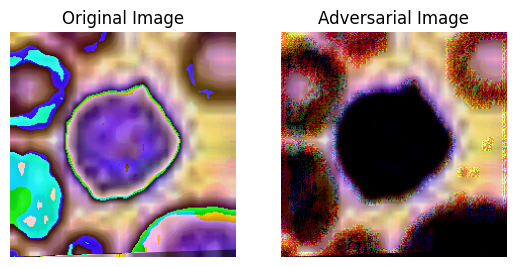

Iteration: 2100, Loss: 0.7287167310714722, Accuracy: 49.714285714285715%


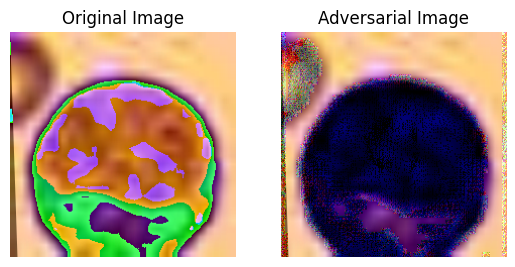

Iteration: 2200, Loss: 1.4584057331085205, Accuracy: 50.36363636363637%


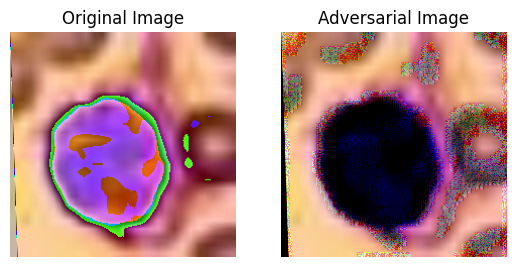

Iteration: 2300, Loss: 0.4922458529472351, Accuracy: 51.08695652173913%


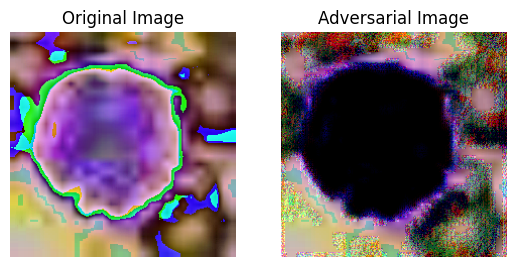

Iteration: 2400, Loss: 0.9994633793830872, Accuracy: 51.458333333333336%


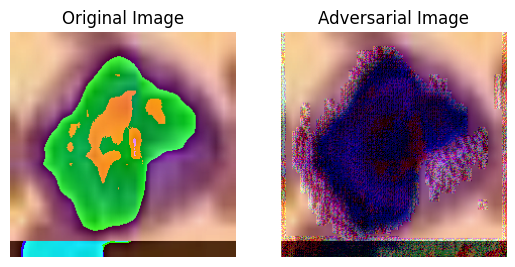

Iteration: 2500, Loss: 0.6217465996742249, Accuracy: 51.76%


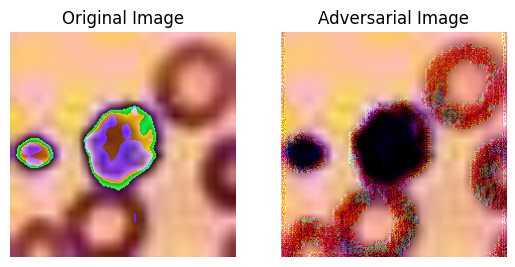

Iteration: 2600, Loss: 1.1780906915664673, Accuracy: 52.15384615384615%


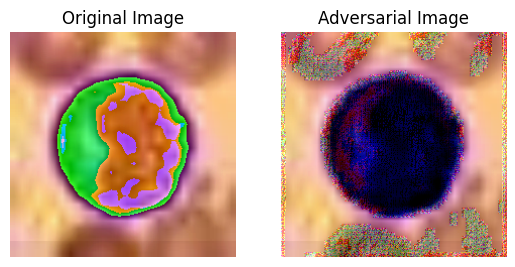

Iteration: 2700, Loss: 1.068998098373413, Accuracy: 52.44444444444444%


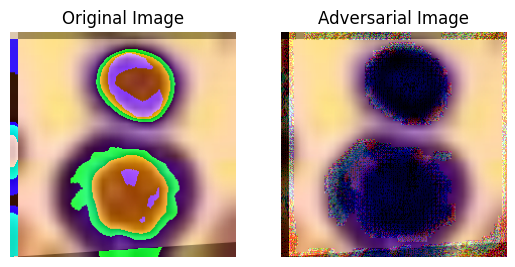

Iteration: 2800, Loss: 0.567300021648407, Accuracy: 52.82142857142857%


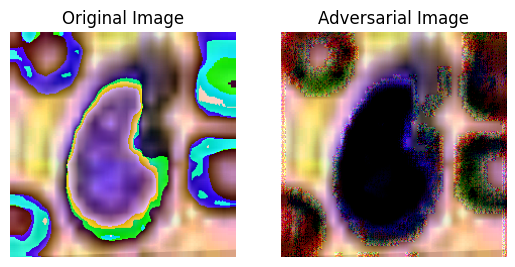

Iteration: 2900, Loss: 0.9890662431716919, Accuracy: 53.172413793103445%


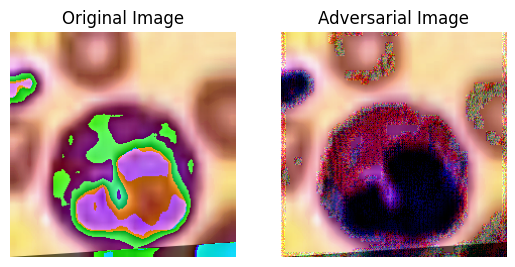

Iteration: 3000, Loss: 0.5846084356307983, Accuracy: 53.733333333333334%


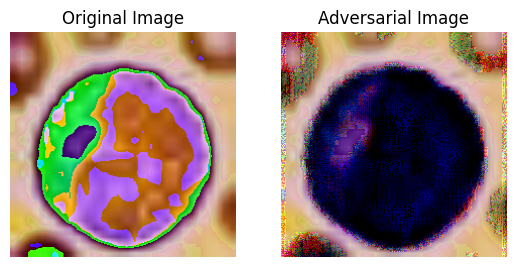

Iteration: 3100, Loss: 1.1111319065093994, Accuracy: 54.096774193548384%


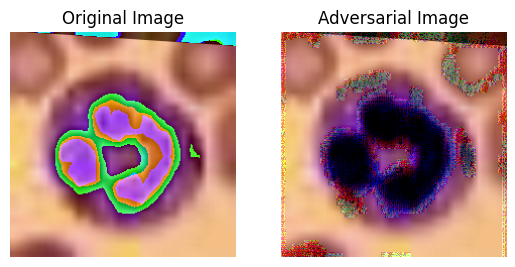

Iteration: 3200, Loss: 1.8783750534057617, Accuracy: 54.5625%


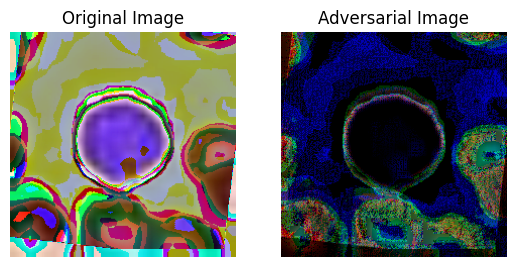

Iteration: 3300, Loss: 0.9619909524917603, Accuracy: 54.93939393939394%


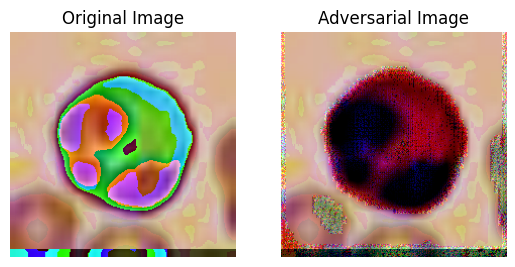

Iteration: 3400, Loss: 1.730733871459961, Accuracy: 54.94117647058823%


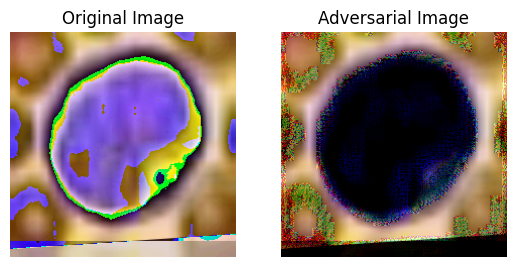

Iteration: 3500, Loss: 1.3968960046768188, Accuracy: 55.142857142857146%


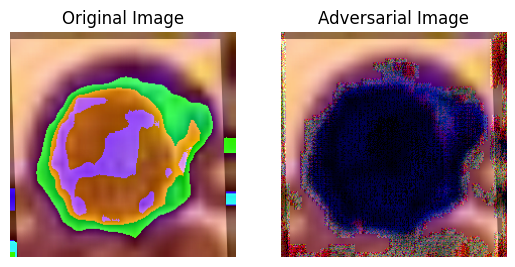

Iteration: 3600, Loss: 0.5785075426101685, Accuracy: 55.27777777777778%


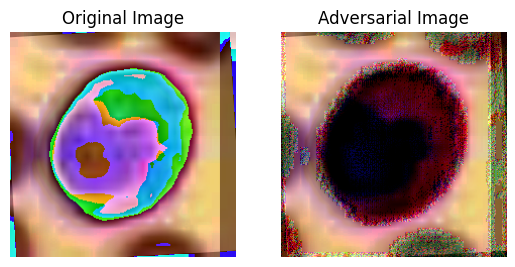

Iteration: 3700, Loss: 0.35456961393356323, Accuracy: 55.729729729729726%


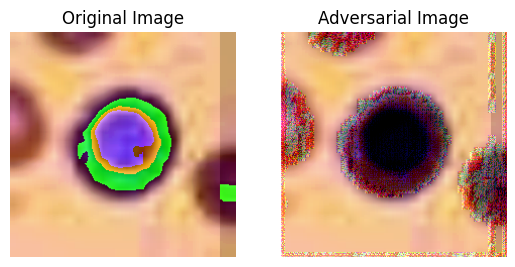

Iteration: 3800, Loss: 1.5830055475234985, Accuracy: 56.0%


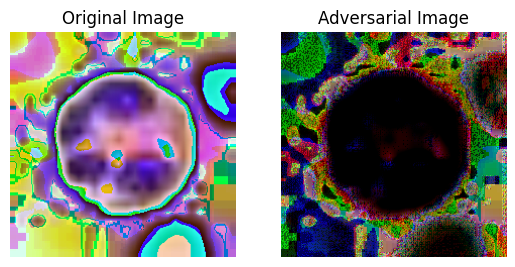

Iteration: 3900, Loss: 0.9012850522994995, Accuracy: 56.282051282051285%


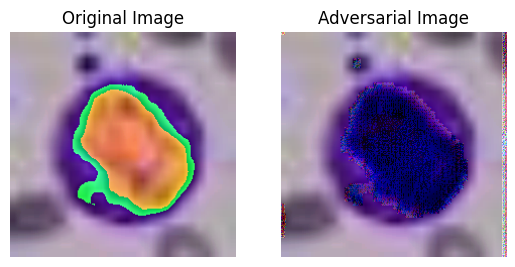

Iteration: 4000, Loss: 0.7895245552062988, Accuracy: 56.65%


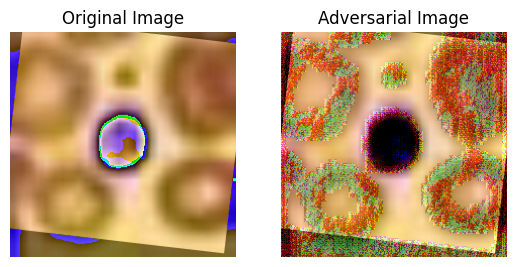

Iteration: 4100, Loss: 0.5836212038993835, Accuracy: 56.75609756097561%


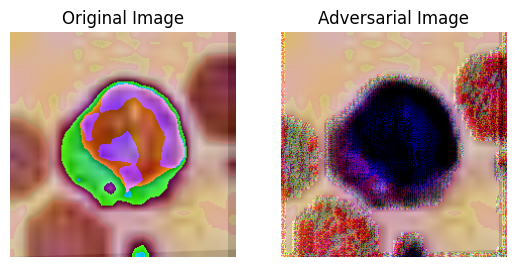

Iteration: 4200, Loss: 0.6379598379135132, Accuracy: 56.95238095238095%


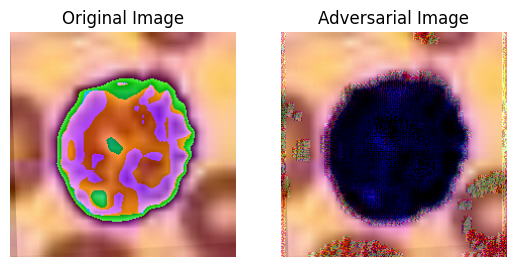

Iteration: 4300, Loss: 0.7695258259773254, Accuracy: 56.97674418604651%


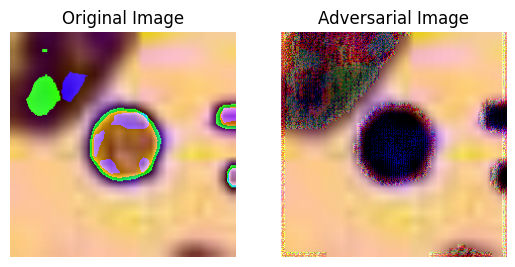

Iteration: 4400, Loss: 0.6355563998222351, Accuracy: 57.31818181818182%


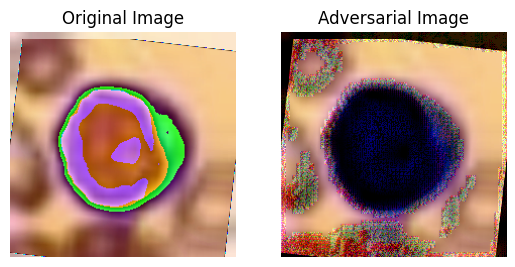

Iteration: 4500, Loss: 0.869625449180603, Accuracy: 57.55555555555556%


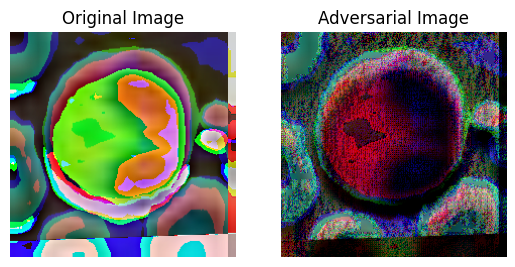

Iteration: 4600, Loss: 1.227081060409546, Accuracy: 57.43478260869565%


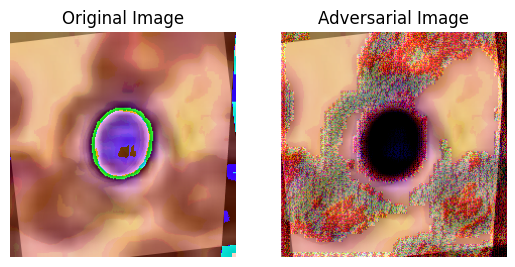

Iteration: 4700, Loss: 0.7647830843925476, Accuracy: 57.59574468085106%


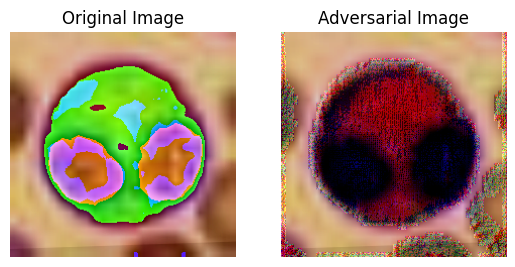

Iteration: 4800, Loss: 0.8548741340637207, Accuracy: 58.041666666666664%


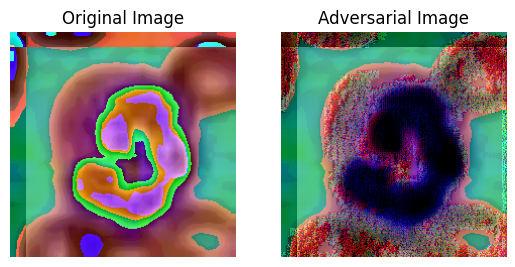

Iteration: 4900, Loss: 1.4195899963378906, Accuracy: 58.06122448979592%


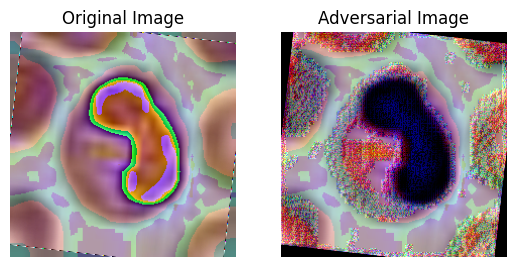

Iteration: 5000, Loss: 0.6654374003410339, Accuracy: 58.38%


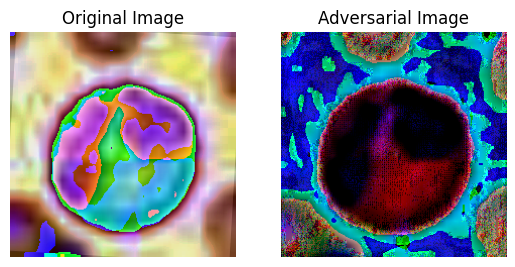

Iteration: 5100, Loss: 0.7431393265724182, Accuracy: 58.568627450980394%


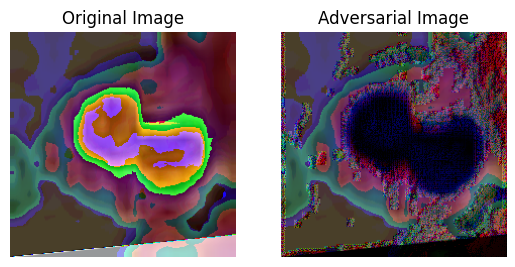

Iteration: 5200, Loss: 1.0037237405776978, Accuracy: 58.67307692307692%


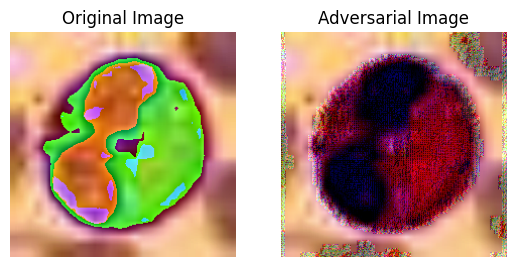

Iteration: 5300, Loss: 0.19985808432102203, Accuracy: 58.735849056603776%


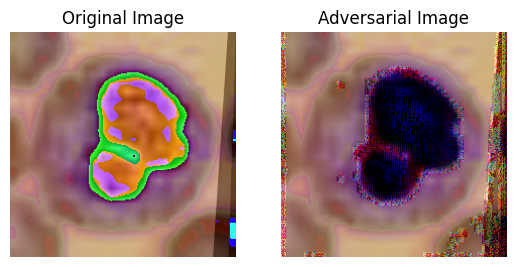

Iteration: 5400, Loss: 0.45740360021591187, Accuracy: 58.907407407407405%


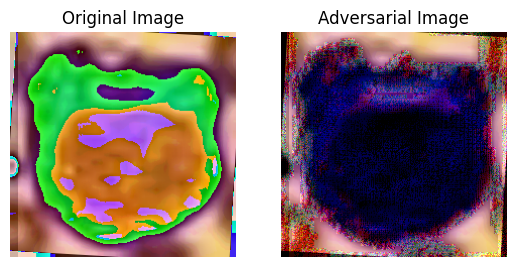

Iteration: 5500, Loss: 0.3132227063179016, Accuracy: 59.14545454545455%


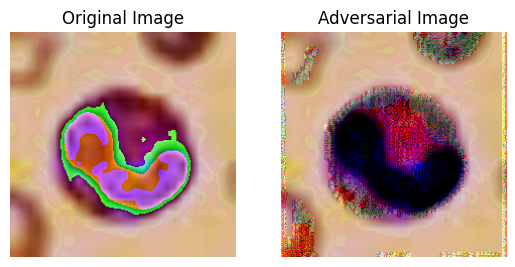

Iteration: 5600, Loss: 0.6904426217079163, Accuracy: 59.30357142857143%


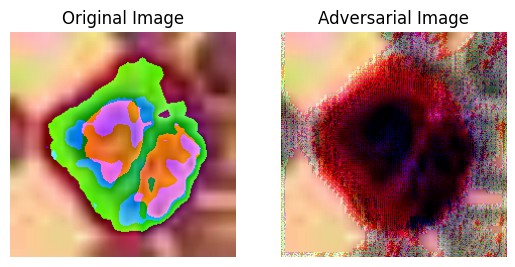

Iteration: 5700, Loss: 1.1327425241470337, Accuracy: 59.473684210526315%


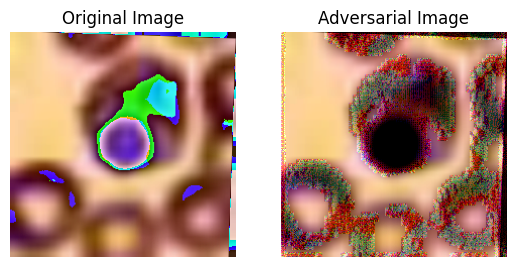

Iteration: 5800, Loss: 0.5204442143440247, Accuracy: 59.741379310344826%


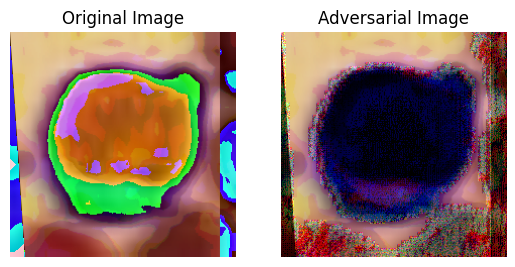

Iteration: 5900, Loss: 0.8626548051834106, Accuracy: 59.94915254237288%


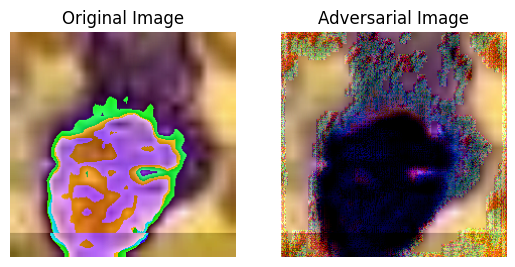

Iteration: 6000, Loss: 0.7994317412376404, Accuracy: 60.15%


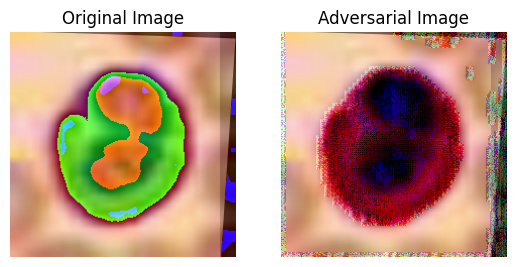

Iteration: 6100, Loss: 0.973779559135437, Accuracy: 60.295081967213115%


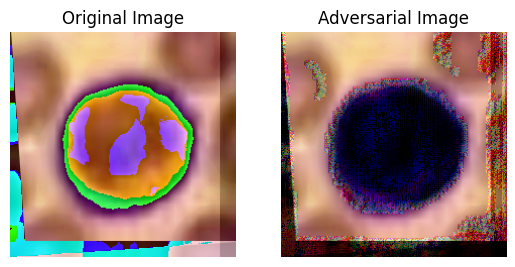

Iteration: 6200, Loss: 1.4231069087982178, Accuracy: 60.596774193548384%


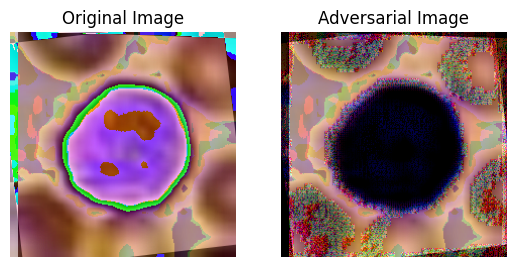

Iteration: 6300, Loss: 1.5341427326202393, Accuracy: 60.63492063492063%


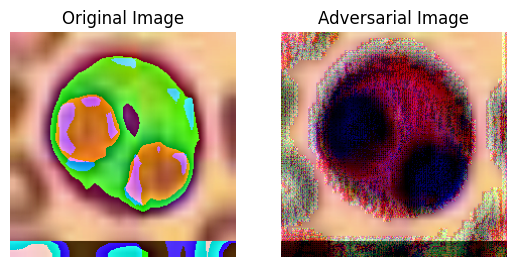

Iteration: 6400, Loss: 1.093238353729248, Accuracy: 60.71875%


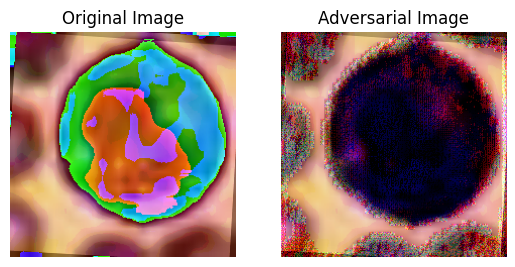

Iteration: 6500, Loss: 0.8794143795967102, Accuracy: 60.96923076923077%


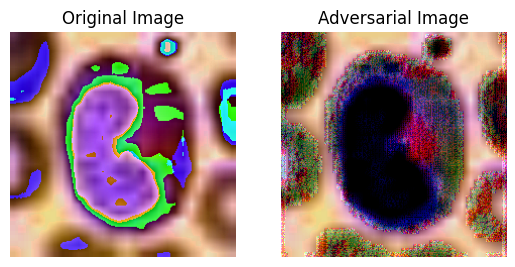

Iteration: 6600, Loss: 0.32523608207702637, Accuracy: 61.22727272727273%


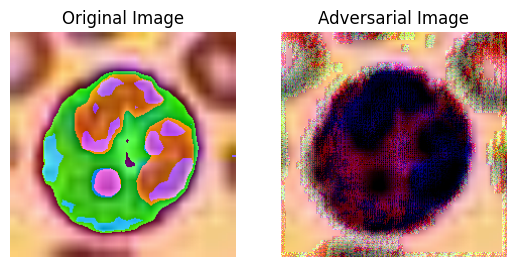

Iteration: 6700, Loss: 0.5182518362998962, Accuracy: 61.417910447761194%


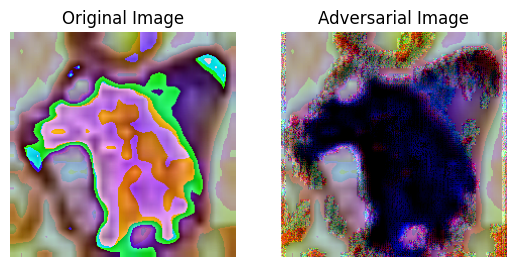

Iteration: 6800, Loss: 0.4124104082584381, Accuracy: 61.6764705882353%


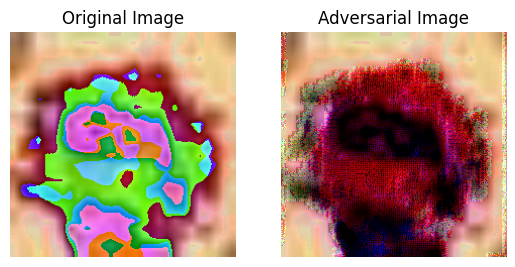

Iteration: 6900, Loss: 0.8462345004081726, Accuracy: 61.95652173913044%


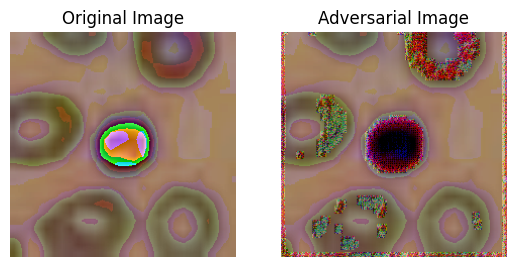

Iteration: 7000, Loss: 0.5303329229354858, Accuracy: 62.128571428571426%


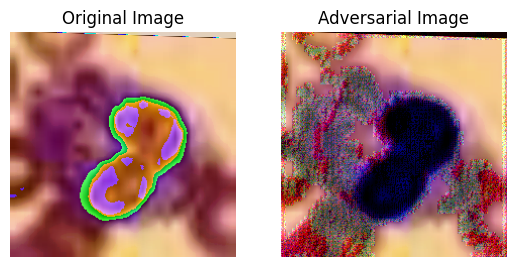

Iteration: 7100, Loss: 0.7427002787590027, Accuracy: 62.225352112676056%


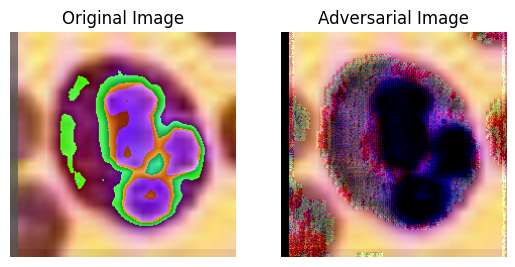

Iteration: 7200, Loss: 0.7353658676147461, Accuracy: 62.375%


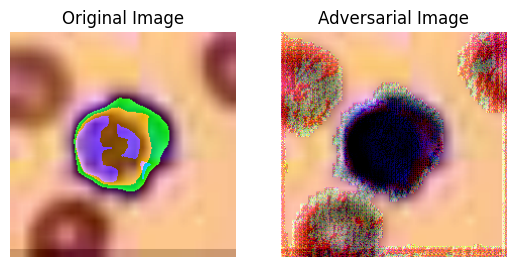

Iteration: 7300, Loss: 0.6254316568374634, Accuracy: 62.47945205479452%


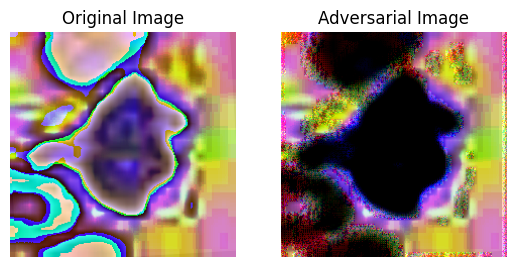

Iteration: 7400, Loss: 0.4235813617706299, Accuracy: 62.648648648648646%


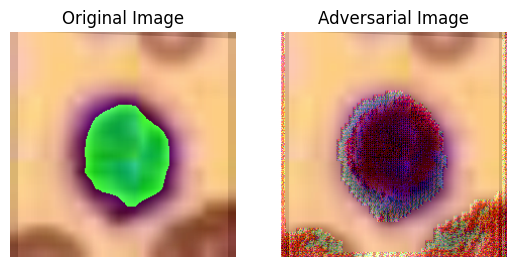

Iteration: 7500, Loss: 0.7509715557098389, Accuracy: 62.76%


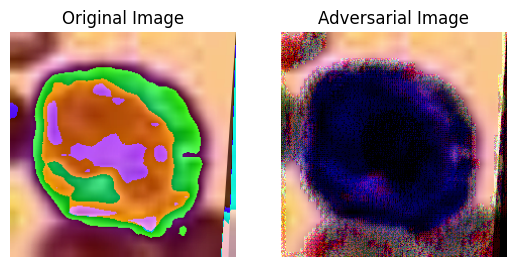

Iteration: 7600, Loss: 1.0049043893814087, Accuracy: 62.85526315789474%


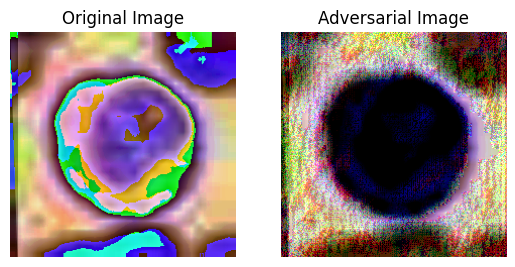

Iteration: 7700, Loss: 0.45487961173057556, Accuracy: 62.896103896103895%


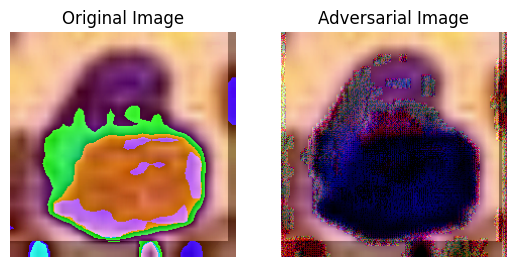

Iteration: 7800, Loss: 0.4364798665046692, Accuracy: 63.05128205128205%


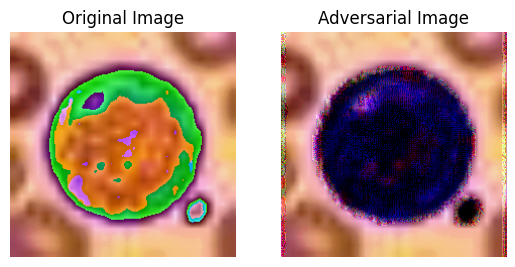

Iteration: 7900, Loss: 1.30086350440979, Accuracy: 63.25316455696203%


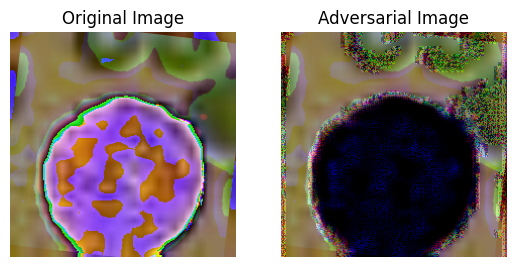

Iteration: 8000, Loss: 0.6190584897994995, Accuracy: 63.3375%


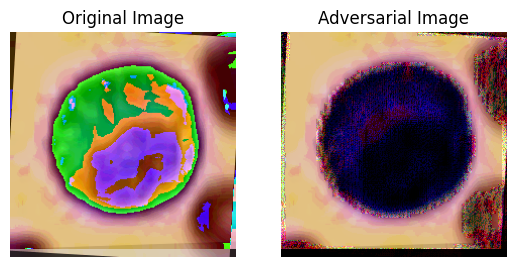

Iteration: 8100, Loss: 0.5413604974746704, Accuracy: 63.45679012345679%


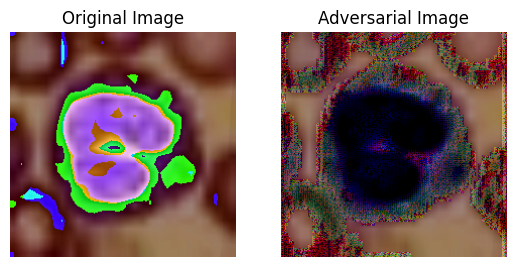

Iteration: 8200, Loss: 0.6818903088569641, Accuracy: 63.5609756097561%


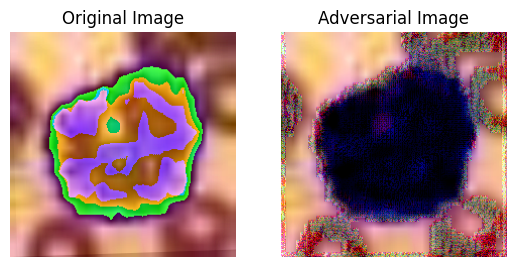

Iteration: 8300, Loss: 0.27005085349082947, Accuracy: 63.71084337349398%


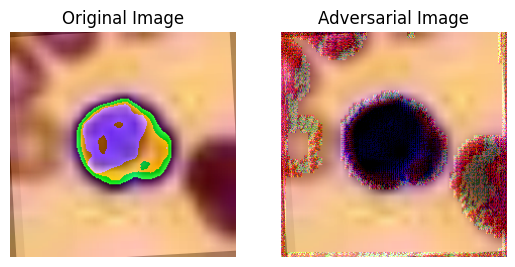

Iteration: 8400, Loss: 0.5712363719940186, Accuracy: 63.79761904761905%


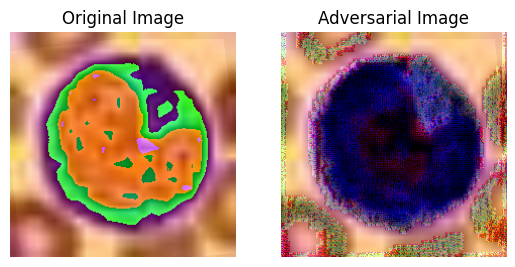

Iteration: 8500, Loss: 0.7175156474113464, Accuracy: 63.95294117647059%


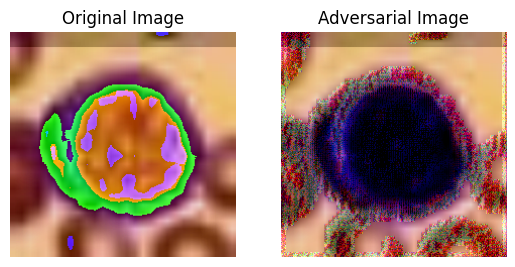

Iteration: 8600, Loss: 1.062684416770935, Accuracy: 64.05813953488372%


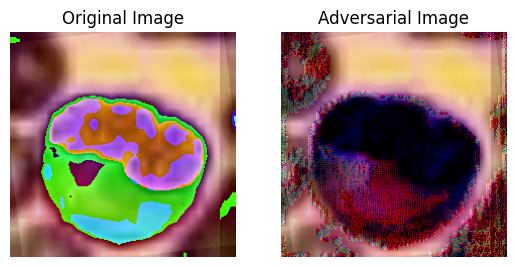

Iteration: 8700, Loss: 1.1070871353149414, Accuracy: 64.06896551724138%


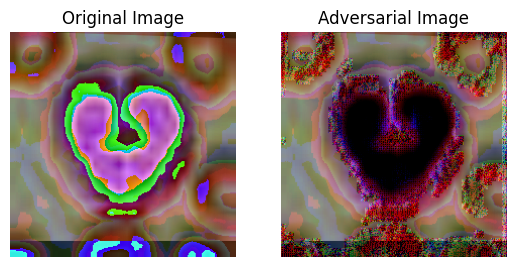

Iteration: 8800, Loss: 0.8374652862548828, Accuracy: 64.10227272727273%


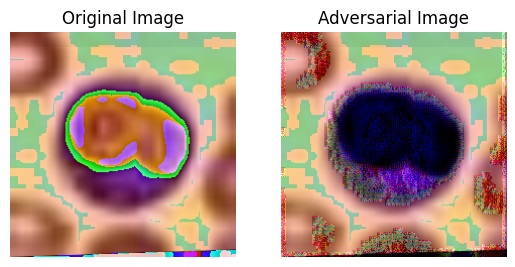

Iteration: 8900, Loss: 1.2870984077453613, Accuracy: 64.12359550561797%


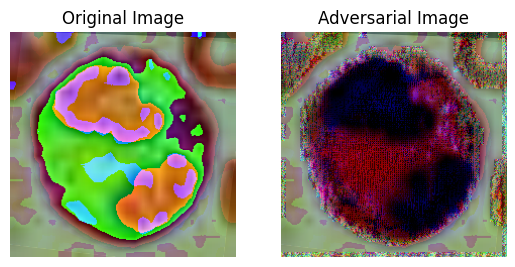

Iteration: 9000, Loss: 0.5641661882400513, Accuracy: 64.1%


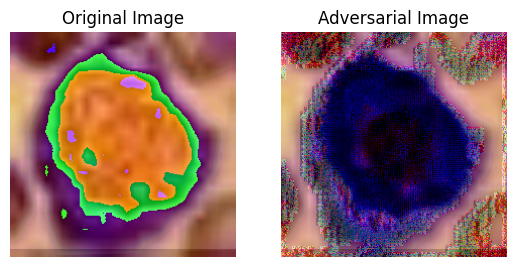

Iteration: 9100, Loss: 0.9411680102348328, Accuracy: 64.07692307692308%


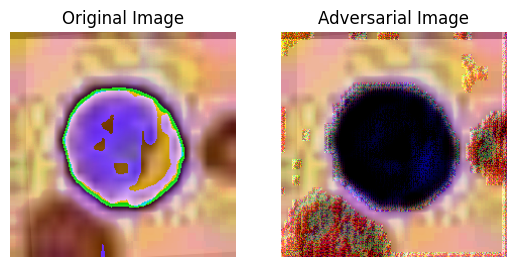

Iteration: 9200, Loss: 0.7707570791244507, Accuracy: 64.16304347826087%


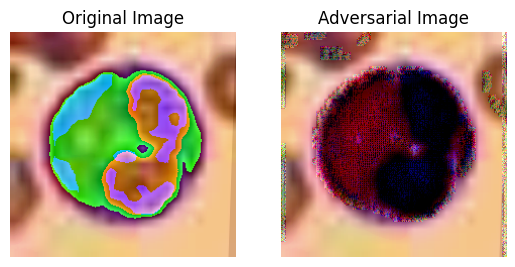

Iteration: 9300, Loss: 0.5892415046691895, Accuracy: 64.25806451612904%


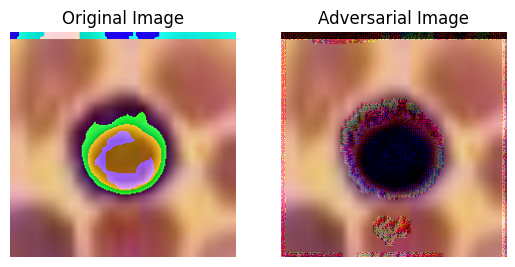

Iteration: 9400, Loss: 1.5210564136505127, Accuracy: 64.32978723404256%


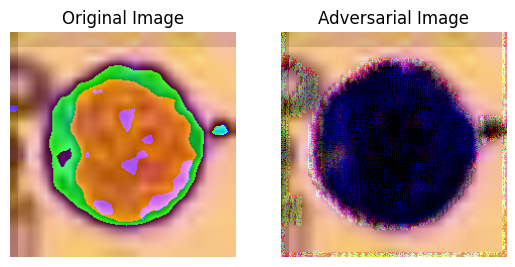

Iteration: 9500, Loss: 0.462944358587265, Accuracy: 64.29473684210527%


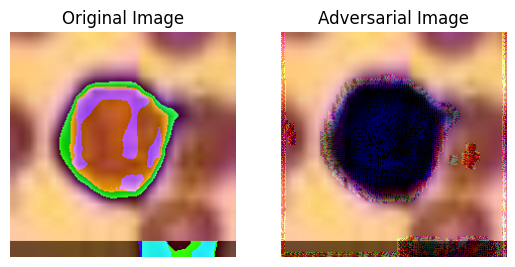

Iteration: 9600, Loss: 0.718580424785614, Accuracy: 64.36458333333333%


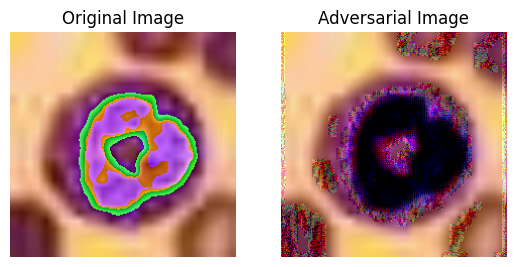

Iteration: 9700, Loss: 0.6304073333740234, Accuracy: 64.4639175257732%


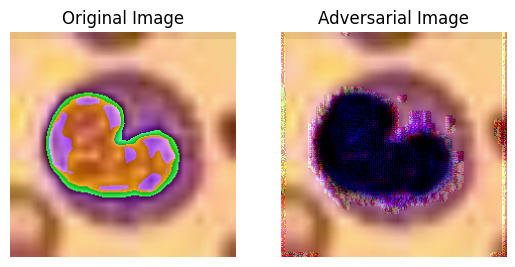

Iteration: 9800, Loss: 0.6392865777015686, Accuracy: 64.61224489795919%


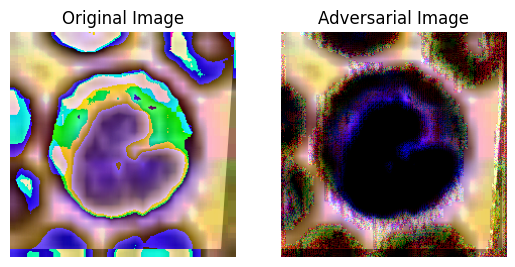

Iteration: 9900, Loss: 0.5418804883956909, Accuracy: 64.73737373737374%


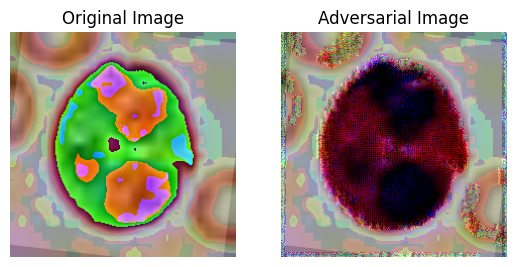

Iteration: 10000, Loss: 0.4645911753177643, Accuracy: 64.83%


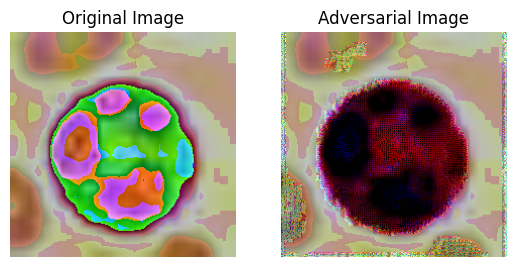

Iteration: 10100, Loss: 0.9706451296806335, Accuracy: 64.93069306930693%


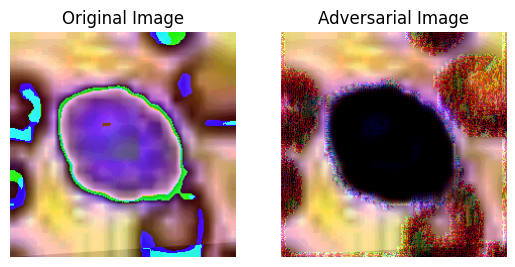

Iteration: 10200, Loss: 0.6556740999221802, Accuracy: 65.0%


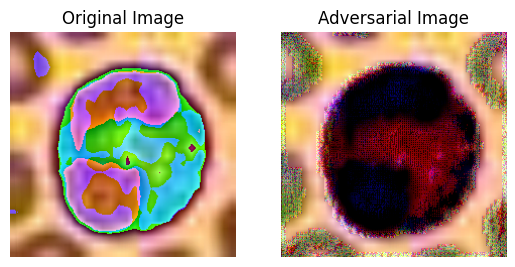

Iteration: 10300, Loss: 0.9053146243095398, Accuracy: 65.04854368932038%


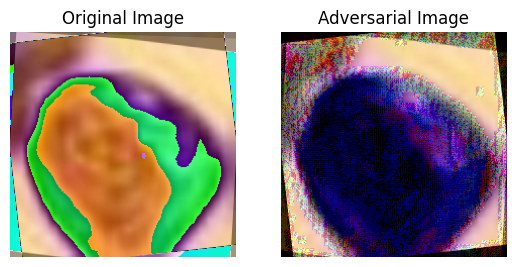

Iteration: 10400, Loss: 0.9004049301147461, Accuracy: 65.11538461538461%


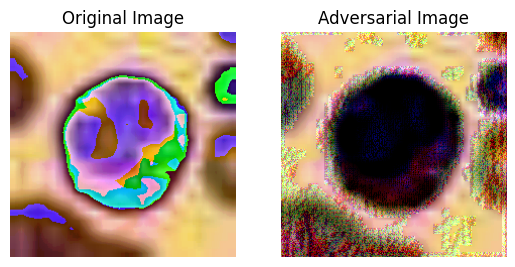

Iteration: 10500, Loss: 0.49864429235458374, Accuracy: 65.2%


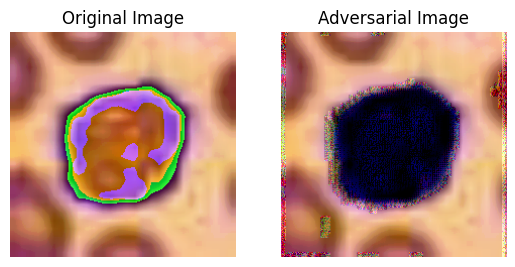

Iteration: 10600, Loss: 0.4638485908508301, Accuracy: 65.29245283018868%


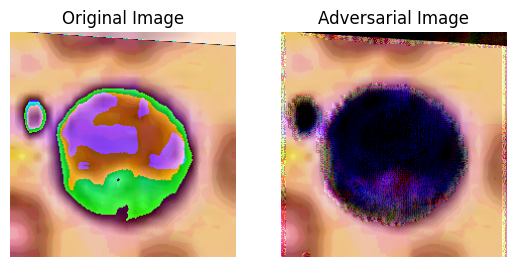

Iteration: 10700, Loss: 1.3530352115631104, Accuracy: 65.3644859813084%


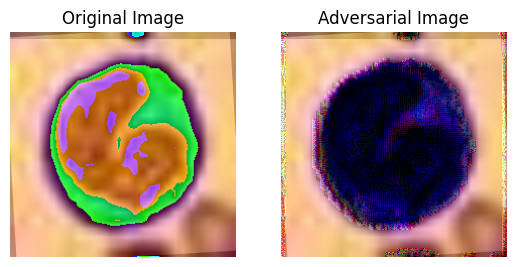

Iteration: 10800, Loss: 0.6653546094894409, Accuracy: 65.44444444444444%


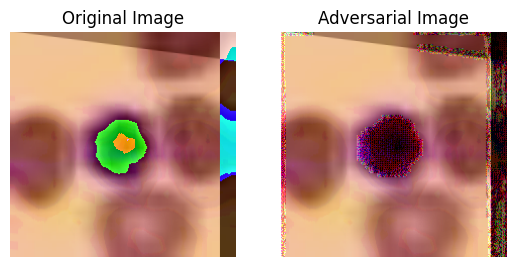

Iteration: 10900, Loss: 1.5448501110076904, Accuracy: 65.4862385321101%


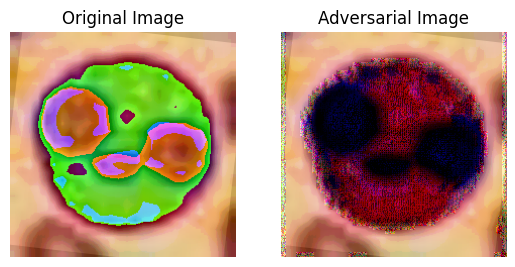

Iteration: 11000, Loss: 0.6194934844970703, Accuracy: 65.5909090909091%


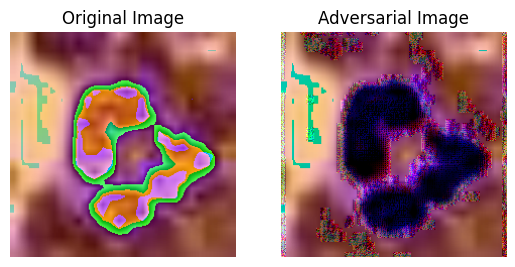

Iteration: 11100, Loss: 0.4693964421749115, Accuracy: 65.61261261261261%


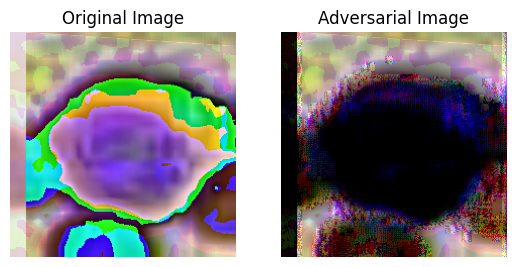

Iteration: 11200, Loss: 0.5237720608711243, Accuracy: 65.64285714285714%


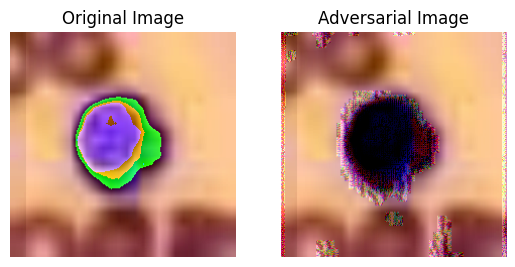

Iteration: 11300, Loss: 0.278867244720459, Accuracy: 65.75221238938053%


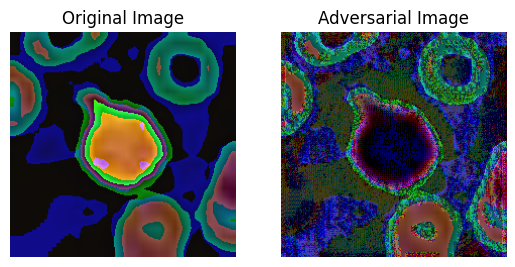

Iteration: 11400, Loss: 0.7469431757926941, Accuracy: 65.7719298245614%


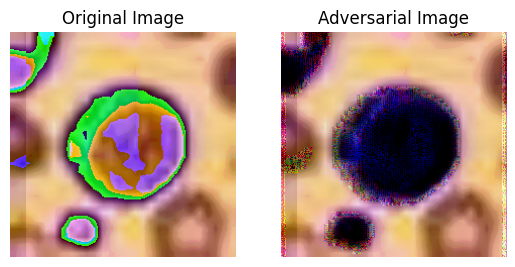

Iteration: 11500, Loss: 0.4669032692909241, Accuracy: 65.84347826086956%


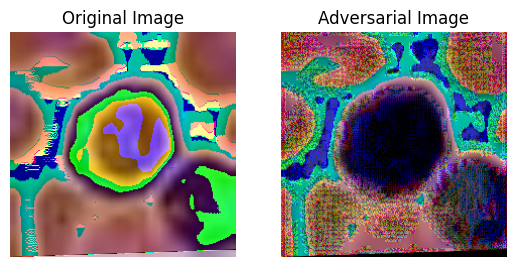

Iteration: 11600, Loss: 1.0325530767440796, Accuracy: 65.87931034482759%


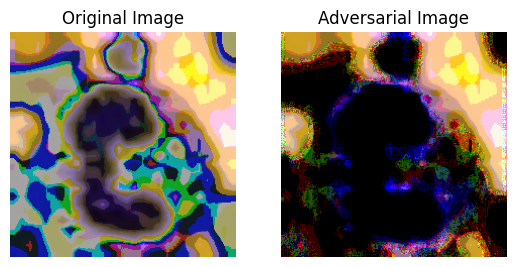

Iteration: 11700, Loss: 0.22569434344768524, Accuracy: 65.98290598290598%


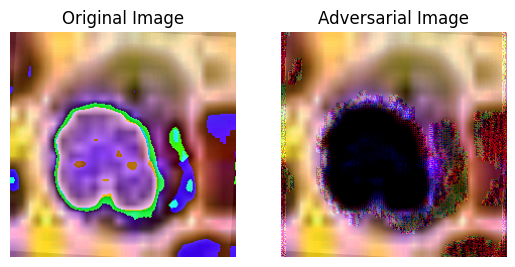

Iteration: 11800, Loss: 0.4053243100643158, Accuracy: 66.12711864406779%


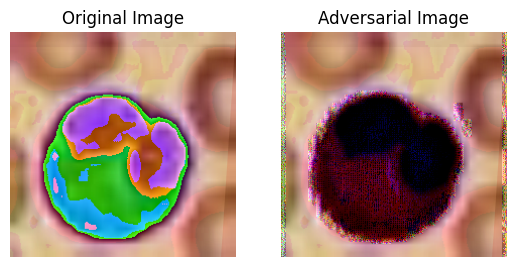

Iteration: 11900, Loss: 0.8973689079284668, Accuracy: 66.21008403361344%


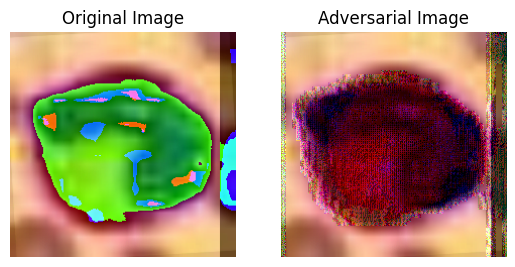

Accuracy on adversarial examples: 66.276445 %
Accuracy on test set: 193.393745 %
Attack Accuracy Score: 0.6627644451877247
Benign Accuracy: 1.9339374451914644


In [20]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

# Define the model architecture
class SimpleModel(nn.Module):
    def __init__(self):
        super(SimpleModel, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)  # Max pooling layer
        self.fc1 = nn.Linear(64 * 56 * 56, 128)  # Adjusted input size based on the output size of the convolutional layers
        self.fc2 = nn.Linear(128, 10)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = torch.flatten(x, 1)  # Flatten the output of the convolutional layers
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

def adversarial_train(model, device, train_loader, optimizer, epsilon):
    model.train()  # Set the model to training mode
    correct = 0
    total = 0
    for data, target in train_loader:
        data, target = data.to(device), target.to(device)
        
        # Generate adversarial examples
        perturbed_data, adv_output = fgsm_attack(model, data, target, epsilon)
        
        # Update model parameters
        optimizer.zero_grad()
        output = model(perturbed_data)
        
        # Calculate loss
        target_flat = target.flatten().long()  # Convert target to Long data type
        loss = F.cross_entropy(output, target_flat)  # Use the flattened target tensor
        
        loss.backward()
        optimizer.step()
        
        # Compute accuracy
        _, predicted = torch.max(output, 1)
        total += target.size(0)
        correct += (predicted == target_flat).sum().item()
        
        # Print adversarial example and predictions
        if total % 100 == 0:  # Print every 100 iterations
            print(f"Iteration: {total}, Loss: {loss.item()}, Accuracy: {100 * correct / total}%")
            
            # Plot original and adversarial images
            original_img = to_pil(data[0].cpu())
            adversarial_img = to_pil(perturbed_data[0].cpu())

            fig, axes = plt.subplots(1, 2)
            axes[0].imshow(original_img)
            axes[0].set_title('Original Image')
            axes[0].axis('off')
            axes[1].imshow(adversarial_img)
            axes[1].set_title('Adversarial Image')
            axes[1].axis('off')
            plt.show()
    
    print('Accuracy on adversarial examples: %f %%' % (100 * correct / total))
    return correct, total



def evaluate(model, device, test_loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            _, predicted = torch.max(output, 1)
            total += target.size(0)  # Increment the total by the batch size
            correct += (predicted == target).sum().item()

    # Check if total is zero to avoid division by zero error
    if total != 0:
        print('Accuracy on test set: %f %%' % (100 * correct / total))
    else:
        print('Accuracy on test set: N/A (total is zero)')
    return correct, total

import torch
import torch.nn.functional as F

def one_hot_encode(target, num_classes):
    """
    Convert target tensor to one-hot encoded format.

    Args:
        target: Target tensor containing class indices.
        num_classes: Number of classes in the classification problem.

    Returns:
        one_hot_target: One-hot encoded target tensor.
    """
    one_hot_target = F.one_hot(target, num_classes=num_classes)
    return one_hot_target.float()

import torch
import torch.nn.functional as F

def fgsm_attack(model, input, target, epsilon):
    """
    FGSM attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label.
        epsilon: Epsilon value for perturbation magnitude.

    Returns:
        adv_input: Adversarial input tensor.
        adv_output: Model output on the adversarial example.
    """
    model.eval()  # Set model to evaluation mode

    # Detach and clone the input tensor (ensure on the same device as model)
    input = input.detach().clone().to(device)
    input.requires_grad_(True)  # Mark input for gradient calculation

    # Original prediction
    output = model(input)

    if torch.is_tensor(target):  # If target is provided as tensor
        if target.dim() > 1:  # If target is provided as class probabilities
            target = target.argmax(dim=1)  # Convert probabilities to indices
        # Ensure target is 1D tensor
        target = target.view(-1)
    else:
        raise ValueError("Target must be provided as a tensor.")

    loss = F.cross_entropy(output, target)

    # Backward pass to obtain the gradient
    model.zero_grad()
    loss.backward()

    # FGSM attack: perturb the input image with gradient sign
    perturbation = epsilon * input.grad.sign()
    adv_input = input + perturbation
    adv_input = torch.clamp(adv_input, min=0.0, max=1.0)  # Clamp to valid range (0.0 to 1.0)

    # Perform inference on the adversarial example
    adv_output = model(adv_input)

    return adv_input, adv_output


def main():
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Initialize model
    model = SimpleModel().to(device)

    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Training parameters
    epochs = 1
    epsilon = 0.2  # Epsilon value for FGSM attack

    # Adversarial training loop
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}:")
        correct_adv, total_adv = adversarial_train(model, device, train_loader, optimizer, epsilon=epsilon)
        correct_benign, total_benign = evaluate(model, device, test_loader)
        
        # Calculate Attack Accuracy score and Benign Accuracy
        attack_accuracy = correct_adv / total_adv
        benign_accuracy = correct_benign / total_benign
        
        print('Attack Accuracy Score:', attack_accuracy)
        print('Benign Accuracy:', benign_accuracy)

# Run the main function
if __name__ == "__main__":
    main()


For the above defense strategy output:

Model Update with Adversarial Examples:

After generating the adversarial examples, the model parameters are updated using these perturbed images.
The loss is calculated based on the model's output on the adversarial examples and the true labels.
Backpropagation is performed through the model to compute the gradients of the loss with respect to the model parameters, and the optimizer updates the model's parameters accordingly.

Training Loop:
This process is repeated for multiple epochs, during which the model learns not only to correctly classify the clean examples but also to resist adversarial perturbations.
By training on both clean and adversarial examples, the model effectively learns a decision boundary that is robust against adversarial attacks.

In this code:

1. We define a simple convolutional neural network (CNN) model called SimpleModel.
2. We implement the Fast Gradient Sign Method (FGSM) attack in the fgsm_attack function.
3. The adversarial_train function performs adversarial training by generating adversarial examples during training and updating the model parameters using these examples.
4. The main function orchestrates the adversarial training process, including loading the dataset, initializing the model and optimizer, and training the model for a specified number of epochs.
5. During each epoch, the model is trained using adversarial examples generated by the fgsm_attack function, and then evaluated on the test set using the evaluate function.

Below Code is the Defense Strategy for Normal FGSM attack  

In [75]:

import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage
from torchvision import transforms
import torchattacks

epsilon = 0.2
to_pil = ToPILImage()

# Normalize input image
normalize = transforms.Normalize(mean=[.5], std=[.5])

# Adversarial training loop
model.train()
for inputs, targets in train_loader:
    inputs, targets = inputs.cuda(), targets.cuda()

    # Original forward + backward + optimize
    optimizer.zero_grad()
    outputs = model(inputs)

    # If targets are one-hot encoded, convert them to class indices
    if len(targets.shape) > 1:
        targets = torch.argmax(targets, dim=1)

    loss = F.cross_entropy(outputs, targets)
    loss.backward()
    optimizer.step()

    # FGSM attack for adversarial training
    fgsm = torchattacks.FGSM(model, eps=epsilon)
    adv_inputs = fgsm(inputs.clone().detach(), targets)
    adv_outputs = model(adv_inputs)
    adv_loss = F.cross_entropy(adv_outputs, targets)

    # Backward pass and optimize for adversarial examples
    optimizer.zero_grad()
    adv_loss.backward()
    optimizer.step()

# Testing loop after adversarial training
model.eval()
for test_inputs, test_targets in test_loader:
    test_inputs, test_targets = test_inputs.cuda(), test_targets.cuda()

    # Forward pass on the original test inputs
    test_outputs = model(test_inputs)

    # If targets are one-hot encoded, convert them to class indices
    if len(test_targets.shape) > 1:
        test_targets = torch.argmax(test_targets, dim=1)

    # FGSM attack on the test inputs
    fgsm = torchattacks.FGSM(model, eps=epsilon)
    target_classes = torch.argmax(test_targets, dim=1)
    adv_test_inputs = fgsm(test_inputs.clone().detach(), target_classes)

    # Forward pass on the adversarial test examples
    adv_test_outputs = model(adv_test_inputs)

    # Your testing logic here...
    # e.g., compare test_outputs and adv_test_outputs, print accuracy, etc.

# Example usage to check if the attack is successful
image_index = 0  # You can choose any index from the test set
input, target = next(iter(test_loader))
input, target = input.cuda(), target.cuda()

# Normalize and clone input for testing
input_normalized = normalize(input)
input_single = input_normalized[image_index].unsqueeze(0).clone().detach()
target_single = target[image_index].item()  # Get the target class for the attack

# Original prediction
output = model(input_single)
output_class_original = torch.argmax(output).cpu().item()

# FGSM attack during testing
adv_input, adv_output = fgsm_attack(model, input_single, target_single, epsilon=epsilon_testing)
output_class_adversarial = torch.argmax(adv_output).cpu().item()

KeyboardInterrupt: 

In [23]:
output_class_original = torch.argmax(outputs, dim=1)
output_class_adversarial = torch.argmax(adv_output, dim=1)

if (output_class_original == output_class_adversarial).all():
  print('Attack Unsuccessful: Original and Adversarial Predictions Match')
else:
  print('Attack Successful: Original and Adversarial Predictions Differ')

Attack Successful: Original and Adversarial Predictions Differ


In [ ]:
# Performing PGD Attack

In [117]:
def pgd_attack(model, input, target, epsilon, alpha, iterations, device="cuda" if torch.cuda.is_available() else "cpu"):
    """
    PGD attack implementation.

    Args:
        model (torch.nn.Module): PyTorch model to be attacked.
        input (torch.Tensor): Input image tensor.
        target (int, optional): Target class label (for targeted attacks). Defaults to None (untargeted attack).
        epsilon (float): Epsilon value for perturbation magnitude.
        alpha (float): Step size for gradient update in PGD.
        iterations (int): Number of iterations for the PGD attack.
        device (str, optional): Device to use for computations (CPU or GPU). Defaults to "cuda" if available, otherwise "cpu".

    Returns:
        adv_input (torch.Tensor): Adversarial input tensor.
        adv_output (torch.Tensor): Model output on the adversarial example.
        is_successful (bool): Boolean indicating attack success (True if prediction changed, False otherwise).
    """

    model.eval()  # Set model to evaluation mode

    # Ensure input and model are on the same device
    input = input.to(device)
    model.to(device)

    # Detach and clone the input tensor
    adv_input = input.detach().clone()
    adv_input.requires_grad_(True)  # Mark input for gradient calculation

    for _ in range(iterations):
        output = model(adv_input)  # Call the model with the adversarial input

        # Calculate loss (targeted vs. untargeted)
        if target is not None:
            # Ensure target is an integer for targeted attacks
            target_tensor = torch.tensor([int(target)]).to(device)
            loss = torch.nn.functional.cross_entropy(output, target_tensor)
        else:
            predicted_class = output.detach().max(1)[1].item()
            loss = torch.nn.functional.cross_entropy(output, torch.tensor([predicted_class]).to(device))

        # Backward pass to obtain the gradient
        model.zero_grad()
        loss.backward()

        # PGD update step
        perturbation = alpha * adv_input.grad.sign()
        adv_input = adv_input + perturbation
        adv_input = torch.clamp(adv_input, min=input - epsilon, max=input + epsilon)
        adv_input = torch.clamp(adv_input, min=0.0, max=1.0)  # Clamp to valid range

        # Reset gradients for next iteration
        model.zero_grad()

    # Perform inference on the adversarial example
    adv_output = model(adv_input)

    # Check attack success (prediction changed from original)
    original_prediction = torch.argmax(model(input.to(device))).item()  # Ensure input on device for prediction
    is_successful = torch.argmax(adv_output).item() != original_prediction

    return adv_input, adv_output, is_successful


# Ensure the model is on the same device as the input
model.to(device)

adv_input, adv_output, is_successful = pgd_attack(model, input, target, epsilon, alpha, iterations)

if is_successful:
    print("Attack Successful! Adversarial prediction:", torch.argmax(adv_output).item())
else:
    print("Attack Unsuccessful. Original and adversarial predictions match.")


OutOfMemoryError: CUDA out of memory. Tried to allocate 50.00 MiB. GPU 0 has a total capacity of 8.00 GiB of which 0 bytes is free. Of the allocated memory 13.71 GiB is allocated by PyTorch, and 1013.19 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

Performing PGD attack on specific images from the dataset

Performing PGD adversarial attack on a subset of images...
Image Index: 2539
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


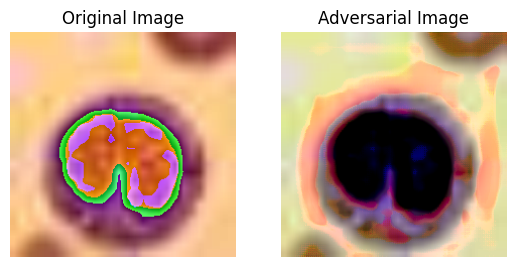

Image Index: 2792
Attack Status: Unsuccessful
Benign Prediction Status: Correct
------------------------


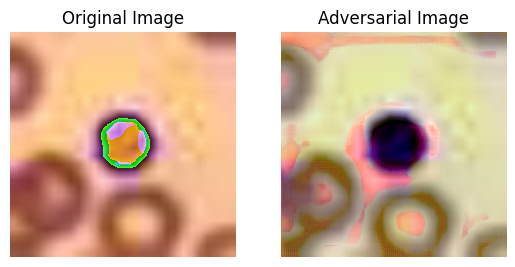

Image Index: 2455
Attack Status: Successful
Benign Prediction Status: Incorrect
------------------------


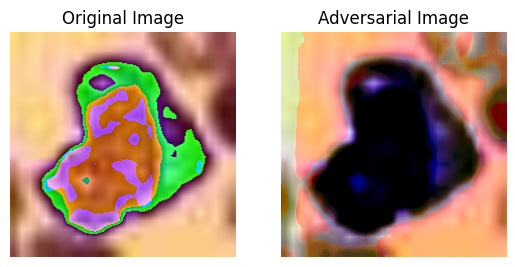

Image Index: 718
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


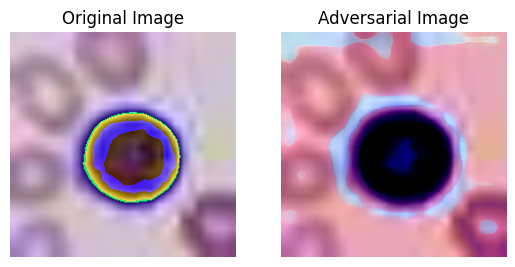

Image Index: 2014
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


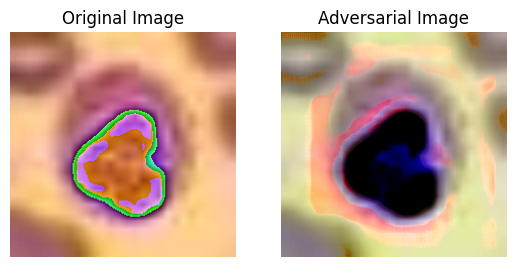

Image Index: 1392
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


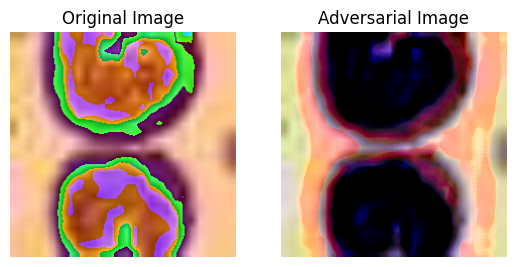

Image Index: 802
Attack Status: Successful
Benign Prediction Status: Incorrect
------------------------


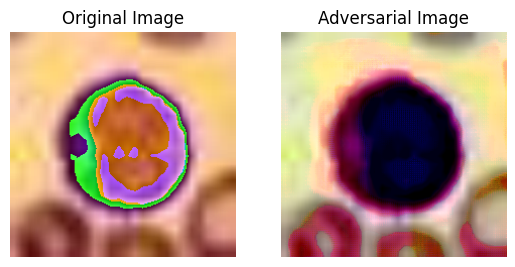

Image Index: 310
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


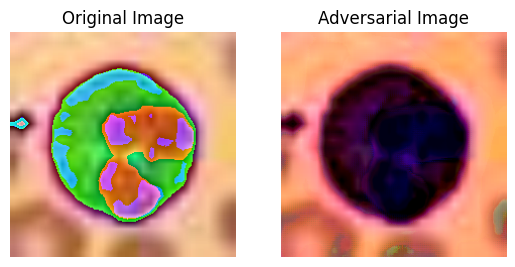

Image Index: 924
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


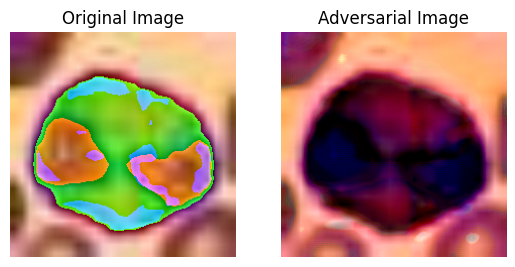

Image Index: 1004
Attack Status: Successful
Benign Prediction Status: Correct
------------------------


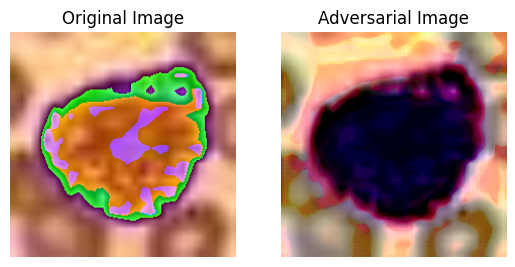

Attack Accuracy: 0.9
Benign Accuracy: 0.8


In [21]:
import torch
import random
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage, transforms
import torchvision.utils as utils
from torchvision.transforms import Normalize
import torch.nn.functional as F

# Define mean and standard deviation for normalization
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Define normalization transformation
normalize = Normalize(mean=mean, std=std)

def pgd_attack(model, input, target, epsilon, alpha, iterations):
    """
    PGD attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label (for untargeted attacks, set to None).
        epsilon: Epsilon value for perturbation magnitude.
        alpha: Step size for each iteration.
        iterations: Number of iterations for the iterative attack.

    Returns:
        adv_input: Adversarial input tensor after multiple iterations.
    """
    # Initialize adversarial input as a clone of the original input
    adv_input = input.clone().detach().to(device)
    adv_input.requires_grad_(True)
    
    for _ in range(iterations):
        # Forward pass
        output = model(adv_input)

        # Calculate loss
        # loss = torch.nn.functional.cross_entropy(output, torch.tensor([target]).to(device) if target is not None else output.detach().max(1)[1])
        num_classes = output.shape[1]
        # target_one_hot = F.one_hot(target, num_classes=num_classes)
        loss = F.cross_entropy(output, target)

        # Backward pass
        model.zero_grad()
        loss.backward()

        # PGD step: perturb the input image with gradient sign and clip to epsilon
        adv_input = adv_input + alpha * adv_input.grad.sign()
        perturbation = torch.clamp(adv_input - input, min=-epsilon, max=epsilon)
        adv_input = torch.clamp(input + perturbation, min=0, max=1).detach()

        # Ensure that the perturbed image is within epsilon ball around original image
        adv_input = torch.max(torch.min(adv_input, input + epsilon), input - epsilon)
        adv_input = torch.clamp(adv_input, 0.0, 1.0)

        # Detach and re-require gradient for next iteration
        adv_input.requires_grad_(True)

    return adv_input


def perform_pgd_attack_on_subset(model, data_loader, num_images, epsilon, alpha, iterations):
    """
    Perform PGD adversarial attack on a random subset of images from the dataset and visualize the results.

    Args:
        model: PyTorch model to be attacked.
        data_loader: DataLoader containing the dataset.
        num_images: Number of images to select randomly from the dataset.
        epsilon: Epsilon value for perturbation magnitude.
        alpha: Step size for each iteration.
        iterations: Number of iterations for the iterative attack.
    """
    successful_attacks = 0
    successful_benign = 0
    images_to_attack = random.sample(range(len(data_loader.dataset)), num_images)
    for index in images_to_attack:
        input, target = data_loader.dataset[index]
        input, target = input.unsqueeze(0).to(device), torch.tensor(target).long().to(device) # Move to device and convert target to tensor

        # PGD attack
        adv_input = pgd_attack(model, input, target, epsilon=epsilon, alpha=alpha, iterations=iterations)

        # Perform inference on the adversarial example
        adv_output = model(adv_input)

        # Check attack status
        if torch.argmax(adv_output).item() != target.item():
            successful_attacks += 1

        # Perform inference on the original example
        output = model(input)
        
        # Check benign prediction status
        if torch.argmax(output).item() == target.item():
            successful_benign += 1

        # Print attack and benign prediction status
        print('Image Index:', index)
        print('Attack Status:', 'Successful' if torch.argmax(adv_output).item() != target.item() else 'Unsuccessful')
        print('Benign Prediction Status:', 'Correct' if torch.argmax(output).item() == target.item() else 'Incorrect')
        print('------------------------')
        to_pil = transforms.ToPILImage()
        # Convert tensors to PIL images for visualization
        original_img = to_pil(input.squeeze(0).cpu())
        adversarial_img = to_pil(adv_input.squeeze(0).cpu())

        # Plot original and adversarial images
        fig, axes = plt.subplots(1, 2)
        axes[0].imshow(original_img)
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(adversarial_img)
        axes[1].set_title('Adversarial Image')
        axes[1].axis('off')
        plt.show()

    # Calculate attack accuracy and benign accuracy
    attack_accuracy = successful_attacks / num_images
    benign_accuracy = successful_benign / num_images
    print('Attack Accuracy:', attack_accuracy)
    print('Benign Accuracy:', benign_accuracy)


# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Example usage
num_images_to_attack = 10  # Number of images to attack (reduced for demonstration)
epsilon_testing = 0.2  # Epsilon value for perturbation magnitude
alpha = 0.01  # Step size for each iteration
iterations = 10  # Number of iterations for PGD

print('Performing PGD adversarial attack on a subset of images...')
perform_pgd_attack_on_subset(model, test_loader, num_images_to_attack, epsilon_testing, alpha, iterations)


In [110]:
print(type(input_single))
print(type(model.weight))

<class 'torch.Tensor'>


AttributeError: 'MedViT' object has no attribute 'weight'

In [112]:
import torch
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage, transforms

to_pil = ToPILImage()

# Normalize input image (check normalization process)
normalize = transforms.Normalize(mean=[.5], std=[.5])

# Define device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def pgd_attack(model, input, target, epsilon, alpha, iterations):
    """
    PGD attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label (for untargeted attacks, set to None).
        epsilon: Epsilon value for perturbation magnitude.
        alpha: Step size for gradient update in PGD.
        iterations: Number of iterations for the PGD attack.

    Returns:
        adv_input: Adversarial input tensor.
        adv_output: Model output on the adversarial example.
    """
    model.eval()  # Set model to evaluation mode

    # Detach and clone the input tensor (ensure on the same device as model)
    input = input.detach().clone().to(device)
    input.requires_grad_(True)  # Mark input for gradient calculation

    adv_input = input.clone()

    for _ in range(iterations):
        output = model(adv_input)  # Call the PyTorch model with the input tensor
        loss = torch.nn.functional.cross_entropy(
            output, torch.tensor([target]).to(device) if target is not None else output.detach().max(1)[1]
        )

        # Backward pass to obtain the gradient
        model.zero_grad()
        loss.backward()

        # PGD update step
        perturbation = alpha * adv_input.grad.sign()
        adv_input = adv_input + perturbation
        adv_input = torch.clamp(adv_input, min=input - epsilon, max=input + epsilon)
        adv_input = torch.clamp(adv_input, min=0.0, max=1.0)  # Clamp to valid range

        # Reset gradients for next iteration
        model.zero_grad()

    # Perform inference on the adversarial example
    adv_output = model(adv_input)

    return adv_input, adv_output


# Assuming your model is defined or loaded by the tiny() function
 # Replace with the correct function call if different

image_index = 0  # Choose an index from the test set
input, target = next(iter(test_loader))
input, target = input.to(device), target.to(device)  # Move to device

# Normalize and clone input for testing (check normalization process)
input_normalized = normalize(input)  # Double-check normalization
input_single = input_normalized[image_index].unsqueeze(0).clone().detach()
target_single = target[image_index].item()  # Get target class

# Original prediction
output = model(input_single)  # Call the model with the input tensor
output_class_original = torch.argmax(output).item()

# Specify epsilon for testing (start lower)
epsilon_testing = 0.2  # Adjust as needed
iterations = 5  # Number of iterations for iterative FGSM

# Choose attack function
attack_fn = pgd_attack

# PGD attack with target class (modify for untargeted attack)
adv_input, adv_output = attack_fn(model, input_single, target_single + 1, epsilon_testing, alpha, iterations)

# Check attack status
attack_success = torch.argmax(adv_output).item() != target_single
print('Attack Status:', 'Successful' if attack_success else 'Unsuccessful')

# Calculate adversarial prediction
output_class_adversarial = torch.argmax(adv_output).item()
print('Original Prediction:', output_class_original)
print('Adversarial Prediction:', output_class_adversarial)


RuntimeError: Input type (torch.cuda.FloatTensor) and weight type (torch.FloatTensor) should be the same

In [37]:
print(input_single.size())  # Print the size of the input tensor
print(input_single.shape)

torch.Size([1, 3, 224, 224])
torch.Size([1, 3, 224, 224])


Defense Strategy Code for PGD Attack

In [25]:
import torch
import torch.nn as nn
import torch.optim as optim
import random
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage, transforms
import torchvision.utils as utils
from torchvision.transforms import Normalize
import torch.nn.functional as F
from torch.utils.data import DataLoader

# Define mean and standard deviation for normalization
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Define normalization transformation
normalize = Normalize(mean=mean, std=std)

def pgd_attack(model, input, target, epsilon, alpha, iterations):
    """
    PGD attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label.
        epsilon: Epsilon value for perturbation magnitude.
        alpha: Step size for each iteration.
        iterations: Number of iterations for the iterative attack.

    Returns:
        adv_input: Adversarial input tensor after multiple iterations.
    """
    adv_input = input.clone().detach().to(device)
    adv_input.requires_grad = True
    
    target = target.to(device)
    
    for _ in range(iterations):
        output = model(adv_input)
        loss = F.cross_entropy(output, target)
        
        model.zero_grad()
        loss.backward()
        
        adv_input = adv_input + alpha * adv_input.grad.sign()
        perturbation = torch.clamp(adv_input - input, min=-epsilon, max=epsilon)
        adv_input = torch.clamp(input + perturbation, min=0, max=1).detach()
        adv_input.requires_grad = True

    return adv_input




def adversarial_training(model, train_loader, test_loader, epsilon, alpha, iterations, num_epochs, learning_rate):
    """
    Adversarial training implementation.

    Args:
        model: PyTorch model to be trained.
        train_loader: DataLoader containing the training dataset.
        test_loader: DataLoader containing the test dataset.
        epsilon: Epsilon value for PGD attack.
        alpha: Step size for PGD attack.
        iterations: Number of iterations for PGD attack.
        num_epochs: Number of training epochs.
        learning_rate: Learning rate for the optimizer.
    """
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    for epoch in range(num_epochs):
        model.train()  
        for inputs, targets in train_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            adv_inputs = pgd_attack(model, inputs, targets, epsilon, alpha, iterations)


            all_inputs = torch.cat([inputs, adv_inputs], dim=0)
            all_targets = torch.cat([targets, targets], dim=0)

            outputs = model(all_inputs)
            loss = criterion(outputs, all_targets)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        attack_accuracy, benign_accuracy = evaluate_defense(model, test_loader, epsilon, alpha, iterations)
        print(f"Epoch {epoch+1}/{num_epochs}:")
        print(f"  Attack Accuracy: {attack_accuracy}")
        print(f"  Benign Accuracy: {benign_accuracy}")

    print("Adversarial training completed.")

def evaluate_defense(model, test_loader, epsilon, alpha, iterations):
    """
    Evaluate the defense strategy by calculating attack accuracy and benign accuracy.

    Args:
        model: PyTorch model to be evaluated.
        test_loader: DataLoader containing the test dataset.
        epsilon: Epsilon value for PGD attack.
        alpha: Step size for PGD attack.
        iterations: Number of iterations for PGD attack.

    Returns:
        attack_accuracy: Attack accuracy score.
        benign_accuracy: Benign accuracy score.
    """
    model.eval()
    correct_benign = 0
    correct_attack = 0
    total = 0

    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            adv_inputs = pgd_attack(model, inputs, targets, epsilon, alpha, iterations)
            
            benign_outputs = model(inputs)
            _, benign_preds = benign_outputs.max(1)
            correct_benign += (benign_preds == targets).sum().item()
            
            adv_outputs = model(adv_inputs)
            _, adv_preds = adv_outputs.max(1)
            correct_attack += (adv_preds == targets).sum().item()

            total += targets.size(0)
            print_images(inputs, adv_inputs)

    benign_accuracy = correct_benign / total
    attack_accuracy = correct_attack / total

    return attack_accuracy, benign_accuracy


def print_images(original_images, adversarial_images):
    """
    Display original and adversarial images side by side.

    Args:
        original_images: Tensor containing original images.
        adversarial_images: Tensor containing adversarial images.
    """
    to_pil = transforms.ToPILImage()
    for i in range(len(original_images)):
        original_img = to_pil(original_images[i].cpu())
        adversarial_img = to_pil(adversarial_images[i].cpu())

        fig, axes = plt.subplots(1, 2)
        axes[0].imshow(original_img)
        axes[0].set_title('Original Image')
        axes[0].axis('off')
        axes[1].imshow(adversarial_img)
        axes[1].set_title('Adversarial Image')
        axes[1].axis('off')
        plt.show()


# Example usage after performing PGD attack
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

epsilon = 0.2
alpha = 0.01
iterations = 5
num_epochs = 1
learning_rate = 0.001

adversarial_training(model, train_loader, test_loader, epsilon, alpha, iterations, num_epochs, learning_rate)


OutOfMemoryError: CUDA out of memory. Tried to allocate 20.00 MiB. GPU 0 has a total capacity of 8.00 GiB of which 0 bytes is free. Of the allocated memory 13.96 GiB is allocated by PyTorch, and 776.72 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [23]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

# Define the model architecture
class SimpleModel(nn.Module):
    def __init__(self):
        super(SimpleModel, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)  # Max pooling layer
        self.fc1 = nn.Linear(64 * 56 * 56, 128)  # Adjusted input size based on the output size of the convolutional layers
        self.fc2 = nn.Linear(128, 10)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = torch.flatten(x, 1)  # Flatten the output of the convolutional layers
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

def adversarial_train_pgd(model, device, train_loader, optimizer, epsilon, alpha, iterations):
    model.train()  # Set the model to training mode
    correct = 0
    total = 0
    for data, target in train_loader:
        data, target = data.to(device), target.to(device)
        
        # Generate adversarial examples
        perturbed_data, adv_output = pgd_attack(model, data, target, epsilon, alpha, iterations)
        
        # Update model parameters
        optimizer.zero_grad()
        output = model(perturbed_data)
        
        # Calculate loss
        target_flat = target.flatten().long()  # Convert target to Long data type
        loss = F.cross_entropy(output, target_flat)  # Use the flattened target tensor
        
        loss.backward()
        optimizer.step()
        
        # Compute accuracy
        _, predicted = torch.max(output, 1)
        total += target.size(0)
        correct += (predicted == target_flat).sum().item()
        
        # Print adversarial example and predictions
        if total % 100 == 0:  # Print every 100 iterations
            print(f"Iteration: {total}, Loss: {loss.item()}, Accuracy: {100 * correct / total}%")
            
            # Plot original and adversarial images
            original_img = to_pil(data[0].cpu())
            adversarial_img = to_pil(perturbed_data[0].cpu())

            fig, axes = plt.subplots(1, 2)
            axes[0].imshow(original_img)
            axes[0].set_title('Original Image')
            axes[0].axis('off')
            axes[1].imshow(adversarial_img)
            axes[1].set_title('Adversarial Image')
            axes[1].axis('off')
            plt.show()
    
    print('Accuracy on adversarial examples: %f %%' % (100 * correct / total))
    return correct, total


def evaluate_pgd(model, device, test_loader, epsilon, alpha, iterations):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            perturbed_data, _ = pgd_attack(model, data, target, epsilon, alpha, iterations)
            output = model(perturbed_data)
            _, predicted = torch.max(output, 1)
            total += target.size(0)  # Increment the total by the batch size
            correct += (predicted == target).sum().item()

    # Check if total is zero to avoid division by zero error
    if total != 0:
        print('Accuracy on test set: %f %%' % (100 * correct / total))
    else:
        print('Accuracy on test set: N/A (total is zero)')
    return correct, total

import torch
import torch.nn.functional as F

def pgd_attack(model, input, target, epsilon, alpha, iterations):
    """
    PGD attack implementation.

    Args:
        model: PyTorch model to be attacked.
        input: Input image tensor.
        target: Target class label.
        epsilon: Epsilon value for perturbation magnitude.
        alpha: Step size for each iteration.
        iterations: Number of iterations for the iterative attack.

    Returns:
        adv_input: Adversarial input tensor after multiple iterations.
        adv_output: Model output on the adversarial example.
    """
    model.eval()  # Set model to evaluation mode

    # Detach and clone the input tensor (ensure on the same device as model)
    input = input.detach().clone().to(device)
    input.requires_grad_(True)  # Mark input for gradient calculation

    # Original prediction
    output = model(input)

    if torch.is_tensor(target):  # If target is provided as tensor
        if target.dim() > 1:  # If target is provided as class probabilities
            target = target.argmax(dim=1)  # Convert probabilities to indices
        # Ensure target is 1D tensor
        target = target.view(-1)
    else:
        raise ValueError("Target must be provided as a tensor.")

    for _ in range(iterations):
        loss = F.cross_entropy(output, target)

        # Backward pass to obtain the gradient
        model.zero_grad()
        loss.backward()

        # PGD attack: perturb the input image with gradient sign
        perturbation = alpha * input.grad.sign()
        adv_input = input + perturbation
        adv_input = torch.clamp(adv_input, min=0.0, max=1.0)  # Clamp to valid range (0.0 to 1.0)

        # Perform inference on the adversarial example
        adv_output = model(adv_input)
        
        # Update original input with adversarial example for next iteration
        input = adv_input.detach().clone()
        input.requires_grad_(True)

    return adv_input, adv_output


def main_pgd():
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Initialize model
    model = SimpleModel().to(device)

    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Training parameters
    epochs = 1
    epsilon = 0.2  # Epsilon value for PGD attack
    alpha = 0.01  # Step size for PGD attack
    iterations = 5  # Number of iterations for PGD attack

    # Adversarial training loop
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}:")
        correct_adv, total_adv = adversarial_train_pgd(model, device, train_loader, optimizer, epsilon, alpha, iterations)
        correct_benign, total_benign = evaluate_pgd(model, device, test_loader, epsilon, alpha, iterations)
        
        # Calculate Attack Accuracy score and Benign Accuracy
        attack_accuracy = correct

ValueError: Expected input batch_size (10) to match target batch_size (100).